In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler



## Cluster Test

In [3]:
data = pd.read_csv('../DataOut/bus_trip_all_points_with_acceleration_and_radial_acceleration_and_distance_and_accDiff.csv')

In [4]:
data

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration,radial_acceleration,distance_from_start,time_diff,acc_diff,acceleration_der
0,574733100,116,2021-10-16 08:03:34,7.293043,80.637552,10.25920,2021-10-16,08:03:34,POINT (184964.84865244984 232317.35306792473),NaN,2.0,1,-0.251980,1.278067,123.738485,0 days 00:00:15,-0.575955,-0.038397
1,574733101,116,2021-10-16 08:03:49,7.292725,80.637707,7.55940,2021-10-16,08:03:49,POINT (184981.95255171193 232282.14959255166),NaN,2.0,1,-0.179987,0.722300,163.044397,0 days 00:00:15,0.071993,0.004800
2,574733102,116,2021-10-16 08:04:04,7.292292,80.637663,3.77970,2021-10-16,08:04:04,POINT (184977.15733984314 232234.22458233108),NaN,2.0,1,-0.251980,0.048332,211.472339,0 days 00:00:15,-0.071993,-0.004800
3,574736662,116,2021-10-16 08:04:19,7.291640,80.637455,9.17927,2021-10-16,08:04:19,POINT (184954.1363920236 232162.16484193364),101,2.0,1,0.359971,1.052222,287.492821,0 days 00:00:15,0.611951,0.040797
4,574736663,116,2021-10-16 08:04:34,7.291210,80.637713,8.63931,2021-10-16,08:04:34,POINT (184982.64260533327 232114.61697960715),101,2.0,1,-0.035997,0.639311,343.141212,0 days 00:00:15,-0.395969,-0.026398
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1154700,1310926397,262,2022-08-09 10:55:05,7.290370,80.638812,20.51840,2022-08-09,10:55:05,POINT (185103.88471817068 232021.69189563429),NaN,5586.0,2,-0.539900,4.312238,16062.472333,0 days 00:00:01,-0.694171,-0.694171
1154701,1310926396,262,2022-08-09 10:55:37,7.291380,80.637410,7.55940,2022-08-09,10:55:37,POINT (184949.15914480377 232133.4259444512),NaN,5586.0,2,-0.404969,0.096588,16253.551165,0 days 00:00:32,0.134931,0.004217
1154702,1310926395,262,2022-08-09 10:55:38,7.291392,80.637387,7.55940,2022-08-09,10:55:38,POINT (184946.57580228115 232134.70946937904),NaN,5586.0,2,0.000000,0.588683,16256.436454,0 days 00:00:01,0.404969,0.404969
1154703,1310926393,262,2022-08-09 10:55:53,7.291295,80.636463,12.95900,2022-08-09,10:55:53,POINT (184844.62591334787 232124.05764201845),NaN,5586.0,2,0.359973,0.563965,16358.837456,0 days 00:00:15,0.359973,0.023998


In [5]:
datain_one_direction=data[(data['direction']==1) & (data['date']<'2022-10-01')]
data_to_cluster=datain_one_direction[['trip_id','deviceid','speed','acceleration','radial_acceleration','acceleration_der']]
# reset index
data_to_cluster=data_to_cluster.reset_index(drop=True)

In [6]:
# get the unique dates in sorted order
data['date'].unique()

array(['2021-10-16', '2021-10-17', '2021-10-18', '2021-10-19',
       '2021-10-21', '2021-10-22', '2021-10-23', '2021-10-24',
       '2021-10-26', '2021-10-27', '2021-10-28', '2021-10-29',
       '2021-10-31', '2021-11-02', '2021-11-03', '2021-11-04',
       '2021-11-07', '2021-11-08', '2021-11-09', '2021-11-11',
       '2021-11-12', '2021-11-13', '2021-11-14', '2021-11-16',
       '2021-11-17', '2021-11-18', '2021-11-19', '2021-11-21',
       '2021-11-22', '2021-11-23', '2021-11-24', '2021-11-26',
       '2021-11-27', '2021-11-28', '2021-11-29', '2021-12-03',
       '2021-12-04', '2021-12-06', '2021-12-07', '2021-12-08',
       '2021-12-09', '2021-12-11', '2021-12-12', '2021-12-13',
       '2021-12-14', '2021-12-16', '2021-12-17', '2021-12-18',
       '2021-12-19', '2021-12-21', '2021-12-22', '2021-12-23',
       '2021-12-24', '2021-12-27', '2021-12-28', '2021-12-29',
       '2022-01-02', '2022-01-03', '2022-01-04', '2022-01-06',
       '2022-01-07', '2022-01-08', '2022-01-09', '2022-

In [7]:
data_to_cluster

,trip_id,deviceid,speed,acceleration,radial_acceleration,acceleration_der
0,2.0,116,10.25920,-0.251980,1.278067,-0.038397
1,2.0,116,7.55940,-0.179987,0.722300,0.004800
2,2.0,116,3.77970,-0.251980,0.048332,-0.004800
3,2.0,116,9.17927,0.359971,1.052222,0.040797
4,2.0,116,8.63931,-0.035997,0.639311,-0.026398
...,...,...,...,...,...,...
524883,5587.0,262,2.15983,-0.057853,0.017268,-0.014922
524884,5587.0,262,2.15983,0.000000,0.050073,0.001653
524885,5587.0,262,2.69978,0.539950,0.056444,0.539950
524886,5587.0,262,5.39957,0.674947,0.062833,0.033749


In [8]:


features_only_df = data_to_cluster[['speed', 'acceleration', 'radial_acceleration','acceleration_der']]


In [9]:
features_only_df

,speed,acceleration,radial_acceleration,acceleration_der
0,10.25920,-0.251980,1.278067,-0.038397
1,7.55940,-0.179987,0.722300,0.004800
2,3.77970,-0.251980,0.048332,-0.004800
3,9.17927,0.359971,1.052222,0.040797
4,8.63931,-0.035997,0.639311,-0.026398
...,...,...,...,...
524883,2.15983,-0.057853,0.017268,-0.014922
524884,2.15983,0.000000,0.050073,0.001653
524885,2.69978,0.539950,0.056444,0.539950
524886,5.39957,0.674947,0.062833,0.033749


In [10]:
# print all the column names
print(features_only_df.columns)

Index(['speed', 'acceleration', 'radial_acceleration', 'acceleration_der'], dtype='object')


In [11]:
# from sklearn.cluster import KMeans
# import matplotlib.pyplot as plt

# # Assuming you have your preprocessed data in 'data_to_cluster_mean'

# # List to store distortion values
# distortions = []

# # Choose a range of cluster counts to try
# cluster_range = range(1, 11)

# # Calculate distortion for each cluster count
# for num_clusters in cluster_range:
#     kmeans = KMeans(n_clusters=num_clusters, random_state=0)
#     kmeans.fit(data_to_cluster_mean)
#     distortions.append(kmeans.inertia_)  # Inertia is the sum of squared distances to the nearest cluster center

# # Plot the elbow curve
# plt.plot(cluster_range, distortions, marker='o')
# plt.xlabel('Number of Clusters')
# plt.ylabel('Distortion')
# plt.title('Elbow Method')
# plt.show()


In [12]:
# get the number of Nan values in each column
print(features_only_df.isna().sum())

speed                  0
acceleration           0
radial_acceleration    0
acceleration_der       0
dtype: int64


c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


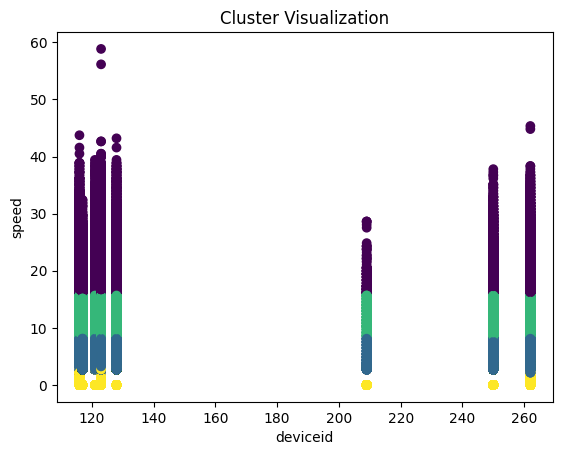

In [13]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Choose the number of clusters
num_clusters = 4

# Initialize the clustering algorithm
kmeans = KMeans(n_clusters=num_clusters, random_state=0)

# Fit the algorithm to your data
kmeans.fit(features_only_df)

# Get cluster assignments for each data point
cluster_labels = kmeans.labels_

# Get cluster centers (centroids)
cluster_centers = kmeans.cluster_centers_

# Add cluster labels to your original dataset
data_with_clusters = pd.DataFrame(features_only_df, columns=['speed', 'acceleration', 'radial_acceleration','acceleration_der'])
data_with_clusters['cluster'] = cluster_labels
data_with_clusters['deviceid'] = data_to_cluster['deviceid']  # Add 'deviceid' column from data_to_cluster
data_with_clusters['trip_id'] = data_to_cluster['trip_id']  

# Visualize the clusters (for 2D data)
plt.scatter(data_with_clusters['deviceid'], data_with_clusters['speed'], c=cluster_labels, cmap='viridis')
plt.xlabel('deviceid')
plt.ylabel('speed')
plt.title('Cluster Visualization')
plt.show()


In [14]:
def draw_clusters(data_with_clusters,x_axis,y_axis):
    # Visualize the clusters (for 2D data)
    plt.scatter(data_with_clusters[x_axis], data_with_clusters[y_axis], c=cluster_labels, cmap='viridis')
    plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], marker='X', s=100, c='red')
    plt.xlabel(x_axis)
    plt.ylabel(y_axis)
    plt.title('Cluster Visualization')
    plt.show()


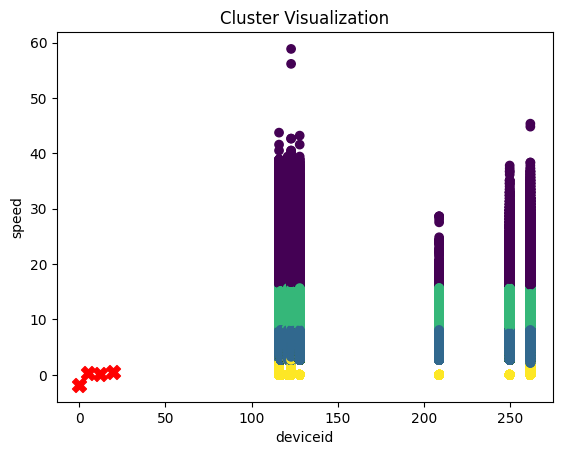

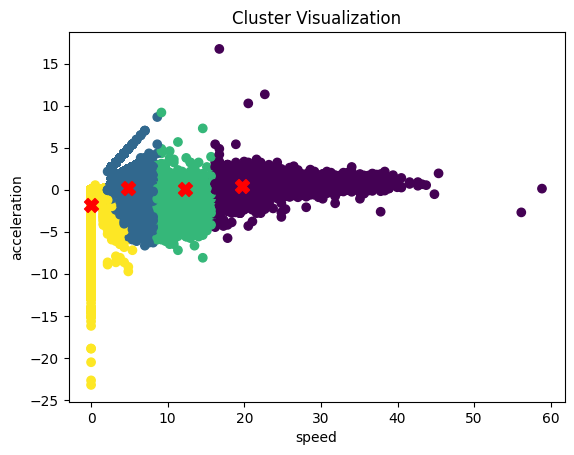

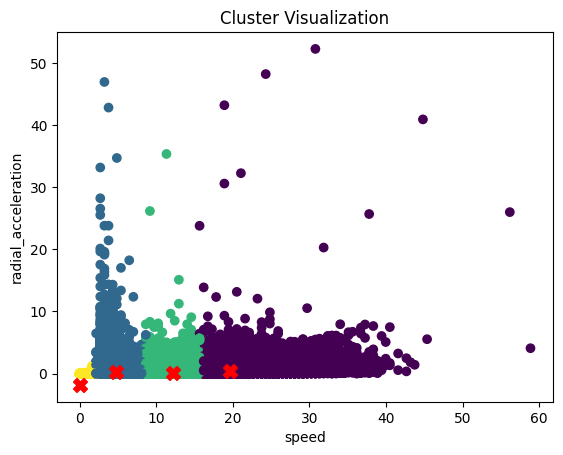

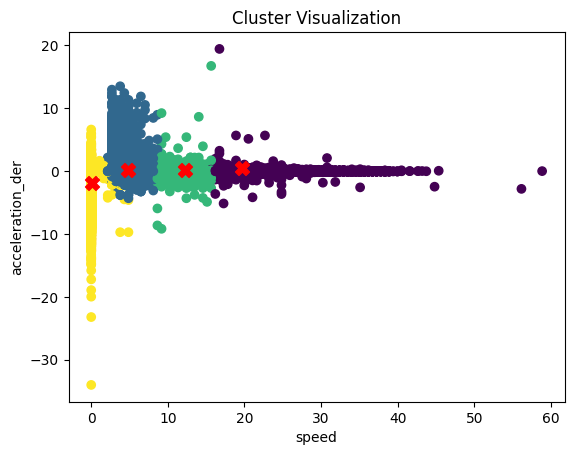

In [15]:
draw_clusters(data_with_clusters,'deviceid','speed')
draw_clusters(data_with_clusters,'speed','acceleration')
draw_clusters(data_with_clusters,'speed','radial_acceleration')
draw_clusters(data_with_clusters,'speed','acceleration_der')

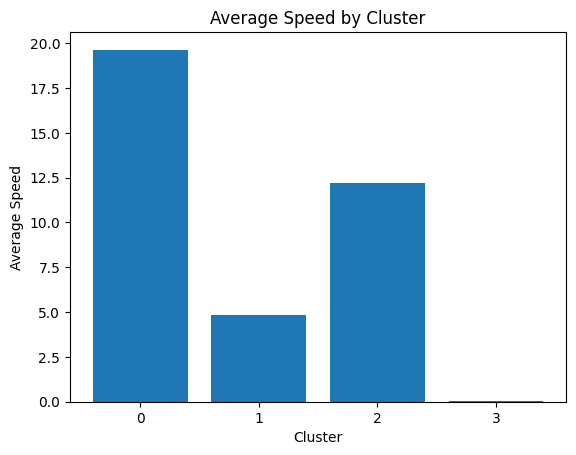

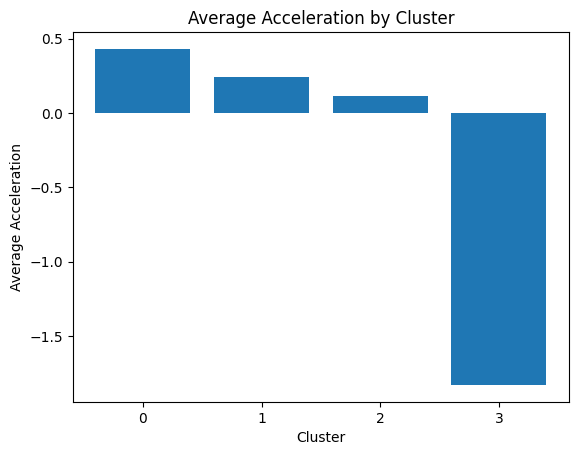

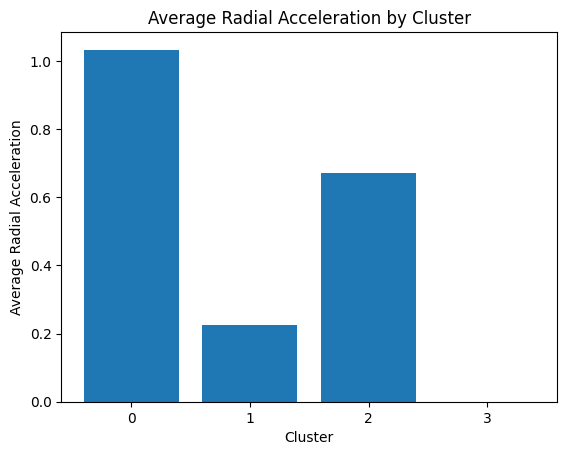

In [16]:
import matplotlib.pyplot as plt

# Calculate average values for each cluster
average_values = data_with_clusters.groupby('cluster').mean()

# Plot bar graph for Average Speed
plt.bar(average_values.index, average_values['speed'])
plt.xlabel('Cluster')
plt.ylabel('Average Speed')
plt.title('Average Speed by Cluster')
plt.xticks(average_values.index)
plt.show()

# Plot bar graph for Average Acceleration
plt.bar(average_values.index, average_values['acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Acceleration')
plt.title('Average Acceleration by Cluster')
plt.xticks(average_values.index)
plt.show()

# Plot bar graph for Average Radial Acceleration
plt.bar(average_values.index, average_values['radial_acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Radial Acceleration')
plt.title('Average Radial Acceleration by Cluster')
plt.xticks(average_values.index)
plt.show()


In [17]:
data_with_clusters

,speed,acceleration,radial_acceleration,acceleration_der,cluster,deviceid,trip_id
0,10.25920,-0.251980,1.278067,-0.038397,2,116,2.0
1,7.55940,-0.179987,0.722300,0.004800,1,116,2.0
2,3.77970,-0.251980,0.048332,-0.004800,1,116,2.0
3,9.17927,0.359971,1.052222,0.040797,2,116,2.0
4,8.63931,-0.035997,0.639311,-0.026398,2,116,2.0
...,...,...,...,...,...,...,...
524883,2.15983,-0.057853,0.017268,-0.014922,1,262,5587.0
524884,2.15983,0.000000,0.050073,0.001653,1,262,5587.0
524885,2.69978,0.539950,0.056444,0.539950,1,262,5587.0
524886,5.39957,0.674947,0.062833,0.033749,1,262,5587.0


In [18]:
cluster_df


NameError: name 'cluster_df' is not defined

In [19]:
# in data dataframe, select all the raws within a given date around a 5 minitues time interval around a given time
data['devicetime']=pd.to_datetime(data['devicetime'])

# Given date and time
given_date = '2021-10-16'
given_time = '08:03:04'

# Convert given time to datetime format
given_datetime = pd.to_datetime('2021-10-27 14:50:45')

# Calculate time range for the interval
time_range = pd.to_timedelta('1 minutes')

# Filter rows within the time interval around the given time
selected_rows = data[
    (data['devicetime'] >= (given_datetime - time_range)) &
    (data['devicetime'] <= (given_datetime + time_range))
]




In [20]:
selected_rows

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration,radial_acceleration,distance_from_start,time_diff,acc_diff,acceleration_der


## Time serious cluster test

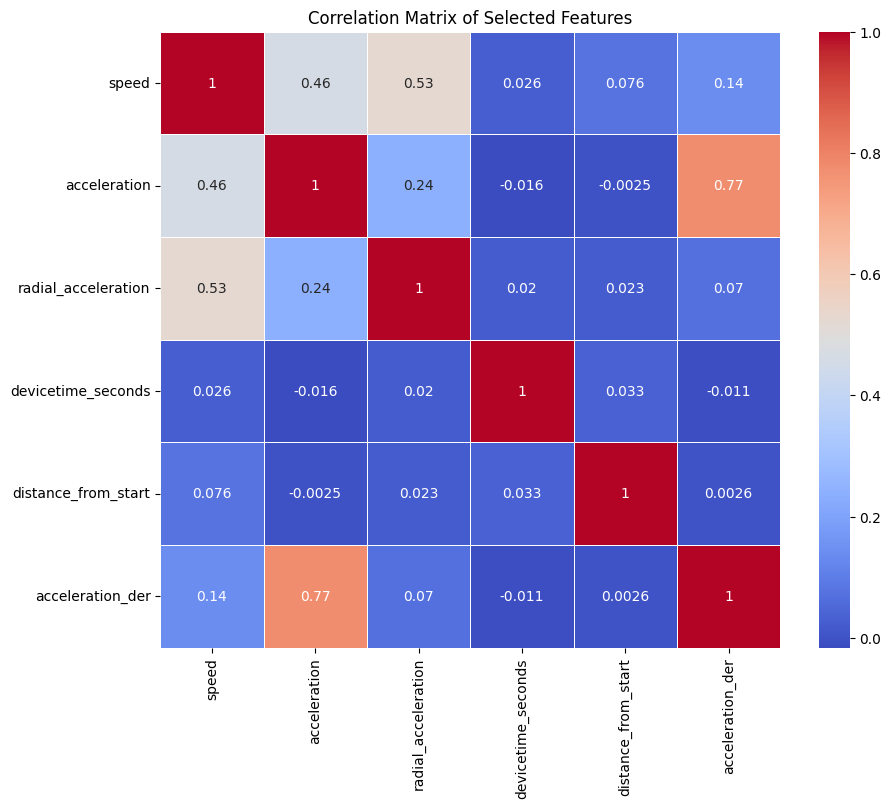

In [21]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load your dataset (assuming it's named 'data')
# data = pd.read_csv('your_dataset.csv')

# Convert 'devicetime' to pandas Timestamp
data['devicetime'] = pd.to_datetime(data['devicetime'])

# Convert 'devicetime' to seconds
data['devicetime_seconds'] = (data['devicetime'] - data['devicetime'].min()).dt.total_seconds()

# Select the features for correlation matrix
selected_features = ['speed', 'acceleration', 'radial_acceleration', 'devicetime_seconds','distance_from_start','acceleration_der']

# Calculate the correlation matrix
correlation_matrix = data[selected_features].corr()

# Create a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=.5)
plt.title("Correlation Matrix of Selected Features")
plt.show()


In [22]:
data

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration,radial_acceleration,distance_from_start,time_diff,acc_diff,acceleration_der,devicetime_seconds
0,574733100,116,2021-10-16 08:03:34,7.293043,80.637552,10.25920,2021-10-16,08:03:34,POINT (184964.84865244984 232317.35306792473),NaN,2.0,1,-0.251980,1.278067,123.738485,0 days 00:00:15,-0.575955,-0.038397,1300995.0
1,574733101,116,2021-10-16 08:03:49,7.292725,80.637707,7.55940,2021-10-16,08:03:49,POINT (184981.95255171193 232282.14959255166),NaN,2.0,1,-0.179987,0.722300,163.044397,0 days 00:00:15,0.071993,0.004800,1301010.0
2,574733102,116,2021-10-16 08:04:04,7.292292,80.637663,3.77970,2021-10-16,08:04:04,POINT (184977.15733984314 232234.22458233108),NaN,2.0,1,-0.251980,0.048332,211.472339,0 days 00:00:15,-0.071993,-0.004800,1301025.0
3,574736662,116,2021-10-16 08:04:19,7.291640,80.637455,9.17927,2021-10-16,08:04:19,POINT (184954.1363920236 232162.16484193364),101,2.0,1,0.359971,1.052222,287.492821,0 days 00:00:15,0.611951,0.040797,1301040.0
4,574736663,116,2021-10-16 08:04:34,7.291210,80.637713,8.63931,2021-10-16,08:04:34,POINT (184982.64260533327 232114.61697960715),101,2.0,1,-0.035997,0.639311,343.141212,0 days 00:00:15,-0.395969,-0.026398,1301055.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1243130,1310926397,262,2022-08-09 10:55:05,7.290370,80.638812,20.51840,2022-08-09,10:55:05,POINT (185103.88471817068 232021.69189563429),NaN,5586.0,2,-0.539900,4.312238,16062.472333,0 days 00:00:01,-0.694171,-0.694171,26972086.0
1243131,1310926396,262,2022-08-09 10:55:37,7.291380,80.637410,7.55940,2022-08-09,10:55:37,POINT (184949.15914480377 232133.4259444512),NaN,5586.0,2,-0.404969,0.096588,16253.551165,0 days 00:00:32,0.134931,0.004217,26972118.0
1243132,1310926395,262,2022-08-09 10:55:38,7.291392,80.637387,7.55940,2022-08-09,10:55:38,POINT (184946.57580228115 232134.70946937904),NaN,5586.0,2,0.000000,0.588683,16256.436454,0 days 00:00:01,0.404969,0.404969,26972119.0
1243133,1310926393,262,2022-08-09 10:55:53,7.291295,80.636463,12.95900,2022-08-09,10:55:53,POINT (184844.62591334787 232124.05764201845),NaN,5586.0,2,0.359973,0.563965,16358.837456,0 days 00:00:15,0.359973,0.023998,26972134.0


In [23]:
# set Nan in bus_stop to 0
data['bus_stop']=data['bus_stop'].fillna(0)
datain_one_direction['bus_stop']=datain_one_direction['bus_stop'].fillna(0)

C:\Users\gw\AppData\Local\Temp\ipykernel_28996\65654468.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  datain_one_direction['bus_stop']=datain_one_direction['bus_stop'].fillna(0)


In [24]:
# see the Nan values in datain_one_direction each column
datain_one_direction.isna().sum()

id                     0
deviceid               0
devicetime             0
latitude               0
longitude              0
speed                  0
date                   0
time                   0
geometry               0
bus_stop               0
trip_id                0
direction              0
acceleration           0
radial_acceleration    0
distance_from_start    0
time_diff              0
acc_diff               0
acceleration_der       0
dtype: int64

In [25]:
Cols_for_clusteringDF=['devicetime', 'radial_acceleration','speed', 'acceleration','distance_from_start','acceleration_der','bus_stop']

In [26]:
from sklearn.preprocessing import StandardScaler

# Create empty lists to store trip IDs and dataframes
processed_trip_ids = []
dataframes_without_trip_id = []

datain_one_direction_no_last_month = datain_one_direction[(datain_one_direction['date'] < '2022-10-01')].copy()

# Iterate through each unique trip_id
for trip_id in datain_one_direction_no_last_month['trip_id'].unique():
    # Filter the data for the current trip_id
    trip_data = datain_one_direction[datain_one_direction['trip_id'] == trip_id].copy()
    
    # Remove the trip_id column from the current trip_data
    trip_data_without_id = trip_data[Cols_for_clusteringDF]
    
    # Ensure selected columns are numeric (e.g., exclude any object or string columns)
    numeric_columns = [ 'radial_acceleration','speed', 'acceleration','distance_from_start','acceleration_der']
    trip_data_without_id [numeric_columns]= trip_data_without_id[numeric_columns].astype(float)  # Convert to float data type
    
    # # Initialize the StandardScaler
    # scaler = StandardScaler()
    
    # columns_to_scale = ['radial_acceleration']

    # # Fit and transform the selected columns
    # trip_data_without_id[columns_to_scale] = scaler.fit_transform(trip_data_without_id[columns_to_scale])
    

    # Append the trip_id to the list
    processed_trip_ids.append(trip_id)
    
    # Append the dataframe without trip_id to the list
    dataframes_without_trip_id.append(trip_data_without_id)

# Print the processed trip IDs and the first few rows of each dataframe
for trip_id, df in zip(processed_trip_ids, dataframes_without_trip_id):
    print(f"Processed Trip ID: {trip_id}")
    print(df.head())  # Print the first few rows of the dataframe
    print("\n")


C:\Users\gw\AppData\Local\Temp\ipykernel_28996\1462363386.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  trip_data_without_id [numeric_columns]= trip_data_without_id[numeric_columns].astype(float)  # Convert to float data type
C:\Users\gw\AppData\Local\Temp\ipykernel_28996\1462363386.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  trip_data_without_id [numeric_columns]= trip_data_without_id[numeric_columns].astype(float)  # Convert to float data type
C:\Users\gw\AppData\Local\Temp\ipykernel_28996

Processed Trip ID: 2.0
            devicetime  radial_acceleration     speed  acceleration  \
0  2021-10-16 08:03:34             1.278067  10.25920     -0.251980   
1  2021-10-16 08:03:49             0.722300   7.55940     -0.179987   
2  2021-10-16 08:04:04             0.048332   3.77970     -0.251980   
3  2021-10-16 08:04:19             1.052222   9.17927      0.359971   
4  2021-10-16 08:04:34             0.639311   8.63931     -0.035997   

   distance_from_start  acceleration_der bus_stop  
0           123.738485         -0.038397        0  
1           163.044397          0.004800        0  
2           211.472339         -0.004800        0  
3           287.492821          0.040797      101  
4           343.141212         -0.026398      101  


Processed Trip ID: 4.0
              devicetime  radial_acceleration    speed  acceleration  \
205  2021-10-16 12:21:15             0.058599  7.01944      0.467963   
206  2021-10-16 12:21:30             0.092952  9.71923      0.179986 

In [27]:
total_dis=0

for index, df in enumerate(dataframes_without_trip_id):
    current_max = df['distance_from_start'].max()
    total_dis+=current_max
    # print(f"Trip ID: {processed_trip_ids[index]} has a distance of {current_max} meters.total distance : {total_dis}.\n")
    
avg_dis=total_dis/len(dataframes_without_trip_id)

print("average distance : ", avg_dis)

average distance :  16164.508455215524


In [28]:
print(len(dataframes_without_trip_id))

2448


In [29]:
# Step 1: Identify the maximum distance_from_start value across all dataframes
max_distance = max(df['distance_from_start'].max() for df in dataframes_without_trip_id)
max_distance

82337.0434658419

In [30]:
new_dataframes = []
new_processed_trip_ids = []

for index, df in enumerate(dataframes_without_trip_id):
    distance_of_the_trip = df['distance_from_start'].max()
    if distance_of_the_trip <= (avg_dis + 250):
        # Keep this DataFrame
        new_dataframes.append(df)
        new_processed_trip_ids.append(processed_trip_ids[index])

# Replace the original lists with the filtered lists
dataframes_without_trip_id = new_dataframes
processed_trip_ids = new_processed_trip_ids


In [31]:
# Step 1: Identify the maximum distance_from_start value across all dataframes
max_distance = max(df['distance_from_start'].max() for df in dataframes_without_trip_id)
max_distance

16357.077311555073

In [32]:
print(len(dataframes_without_trip_id))

2365


In [33]:
dataframes_without_trip_id[1]

,devicetime,radial_acceleration,speed,acceleration,distance_from_start,acceleration_der,bus_stop
205,2021-10-16 12:21:15,0.058599,7.01944,0.467963,40.639631,0.057595,0
206,2021-10-16 12:21:30,0.092952,9.71923,0.179986,110.740656,-0.019198,0
207,2021-10-16 12:21:45,0.483596,8.63931,-0.071995,193.101564,-0.016799,0
208,2021-10-16 12:22:00,0.751005,4.85961,-0.251980,236.850009,-0.011999,0
209,2021-10-16 12:22:15,0.024231,4.31966,-0.035997,271.835124,0.014399,0
...,...,...,...,...,...,...,...
436,2021-10-16 13:17:33,0.000000,0.00000,-1.529875,15616.015197,-0.187485,0
437,2021-10-16 13:17:48,0.405917,8.63931,0.575954,15644.008931,0.140389,0
438,2021-10-16 13:18:03,0.916469,15.11880,0.431966,15733.065369,-0.009599,0
439,2021-10-16 13:18:18,1.369753,14.57880,-0.036000,15855.685329,-0.031198,0


In [34]:
# delete rows with duplicate distance_from_start values in each data frames in dataframes_without_trip_id list
for df in dataframes_without_trip_id:
    df.drop_duplicates(subset=['distance_from_start'], keep='first', inplace=True)

In [35]:
df

,devicetime,radial_acceleration,speed,acceleration,distance_from_start,acceleration_der,bus_stop
624406,2022-08-06 12:16:27,2.512797,5.39957,1.349895,5.881452,0.607453,0
624407,2022-08-06 12:16:47,0.035418,1.61987,-0.188985,21.920685,-0.076944,0
624408,2022-08-06 12:16:48,0.088663,3.23974,1.619870,39.545919,1.808855,0
624409,2022-08-06 12:16:49,0.142277,4.31966,1.079920,54.139268,-0.539950,0
624410,2022-08-06 12:17:22,0.005041,1.07991,-0.098174,261.714931,-0.035700,0
624411,2022-08-06 12:17:24,0.179827,3.77970,1.349895,300.288807,0.724035,0
624412,2022-08-06 12:17:25,0.214232,4.31966,0.539960,304.864817,-0.809935,0
624413,2022-08-06 12:17:51,0.426888,4.31966,0.000000,391.266253,-0.020768,0
624414,2022-08-06 12:17:52,0.128446,5.93953,1.619870,410.603176,1.619870,0
624415,2022-08-06 12:18:01,0.000000,0.00000,-0.659948,445.081289,-0.253313,0


In [36]:
# Assuming dataframes_without_trip_id is a list of dataframes with 'devicetime' column
for df in dataframes_without_trip_id:
    df['devicetime'] = pd.to_datetime(df['devicetime'])  # Convert to datetime if not already
    
    # Calculate time difference in seconds since trip start
    df['devicetime'] = (df['devicetime'] - df['devicetime'].min()).dt.total_seconds()

    # Print the updated dataframe
    print(df)

     devicetime  radial_acceleration     speed  acceleration  \
0           0.0             1.278067  10.25920     -0.251980   
1          15.0             0.722300   7.55940     -0.179987   
2          30.0             0.048332   3.77970     -0.251980   
3          45.0             1.052222   9.17927      0.359971   
4          60.0             0.639311   8.63931     -0.035997   
..          ...                  ...       ...           ...   
200      2954.0             0.000000   0.00000     -0.791940   
201      2969.0             0.481587   7.55940      0.503960   
202      2984.0             0.155985  15.11880      0.503960   
203      2999.0             1.672843  18.35850      0.215980   
204      3014.0             0.000000   4.85961     -0.899926   

     distance_from_start  acceleration_der bus_stop  
0             123.738485         -0.038397        0  
1             163.044397          0.004800        0  
2             211.472339         -0.004800        0  
3             2

C:\Users\gw\AppData\Local\Temp\ipykernel_28996\3500269481.py:3: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['devicetime'] = pd.to_datetime(df['devicetime'])  # Convert to datetime if not already
C:\Users\gw\AppData\Local\Temp\ipykernel_28996\3500269481.py:3: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['devicetime'] = pd.to_datetime(df['devicetime'])  # Convert to datetime if not already


       devicetime  radial_acceleration     speed  acceleration  \
27181         0.0             0.000000   0.00000      0.000000   
27182        15.0             0.174544   9.71923      0.647949   
27183        30.0             0.057537  11.33910      0.107991   
27184        45.0             0.000000   0.00000     -0.755940   
27185        60.0             0.027958   4.85961      0.323974   
...           ...                  ...       ...           ...   
27384      2924.0             0.000000   0.00000     -0.935927   
27385      2939.0             0.241709   6.47948      0.431965   
27386      2954.0             1.371930  14.57880      0.539955   
27387      2969.0             1.283687  14.57880      0.000000   
27388      2984.0             0.000000  11.87910     -0.179980   

       distance_from_start  acceleration_der bus_stop  
27181             0.000000          0.021598        0  
27182            68.486952          0.043197        0  
27183           161.318175         -0.0

C:\Users\gw\AppData\Local\Temp\ipykernel_28996\3500269481.py:3: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['devicetime'] = pd.to_datetime(df['devicetime'])  # Convert to datetime if not already


        devicetime  radial_acceleration     speed  acceleration  \
275594         0.0             0.006596   6.47948     -0.143989   
275595        15.0             0.071430   6.47948      0.000000   
275596        30.0             0.387658   4.31966     -0.143988   
275597        34.0             0.000000   0.00000     -1.079915   
275598        44.0             0.129007   4.85961      0.485961   
...            ...                  ...       ...           ...   
275698      3025.0             0.000000   0.00000     -1.439887   
275699      3028.0             0.004098   6.47948      2.159827   
275700      3043.0             1.023307  11.87910      0.359975   
275701      3058.0             1.657139  15.65880      0.251980   
275702      3073.0             0.000000   6.47948     -0.611955   

        distance_from_start  acceleration_der bus_stop  
275594            73.016307         -0.035997        0  
275595           127.623828          0.009599        0  
275596           181.651

In [37]:
dataframes_without_trip_id[2].head(20)

,devicetime,radial_acceleration,speed,acceleration,distance_from_start,acceleration_der,bus_stop
441,0.0,0.207373,6.47948,0.431965,22.809853,0.059995,0
442,15.0,0.097039,5.93953,-0.035997,85.025496,-0.031197,0
443,30.0,0.014021,8.09935,0.143988,157.635054,0.011999,0
444,45.0,0.000000,0.00000,-0.539957,203.417153,-0.045596,0
445,60.0,0.888259,5.39957,0.359971,235.580231,0.059995,0
446,75.0,0.039453,4.31966,-0.071994,281.142239,-0.028798,0
447,90.0,0.410817,8.63931,0.287977,352.469453,0.023998,101
448,105.0,1.506472,9.71923,0.071995,417.108821,-0.014399,101
449,120.0,0.000000,0.00000,-0.647949,471.350128,-0.047996,101
450,135.0,0.000000,0.00000,0.000000,471.608731,0.043197,101


In [38]:
# import bus trips
bus_trips = pd.read_csv("../DataOut/bus_trips.csv")

bus_trips

,trip_id,deviceid,date,start_terminal,end_terminal,direction,start_time,end_time,duration,duration_in_mins,day_of_week,hour_of_day
0,1.0,116,2021-10-16,BT02,BT01,2,07:08:31,07:53:04,0:44:33,44.550000,5,7
1,2.0,116,2021-10-16,BT01,BT02,1,08:03:04,08:53:48,0:50:44,50.733333,5,8
2,3.0,116,2021-10-16,BT02,BT01,2,10:50:19,11:44:43,0:54:24,54.400000,5,10
3,4.0,116,2021-10-16,BT01,BT02,1,12:20:45,13:18:33,0:57:48,57.800000,5,12
4,5.0,116,2021-10-16,BT02,BT01,2,14:14:36,15:07:05,0:52:29,52.483333,5,14
...,...,...,...,...,...,...,...,...,...,...,...,...
15886,15891.0,1719,2022-02-25,BT01,BT02,1,09:42:39,10:34:59,0:52:20,52.333333,4,9
15887,15892.0,1719,2022-02-25,BT02,BT01,2,12:20:33,13:15:43,0:55:10,55.166667,4,12
15888,15893.0,1719,2022-02-25,BT01,BT02,1,13:41:19,14:38:03,0:56:44,56.733333,4,13
15889,15894.0,1719,2022-02-25,BT02,BT01,2,16:00:04,16:48:05,0:48:01,48.016667,4,16


In [39]:
# sort bus_trips dataframe by duration_in_mins , in dessending order
bus_trips.sort_values(by=['duration_in_mins'], ascending=False, inplace=True)

In [40]:
bus_trips.head(40)

,trip_id,deviceid,date,start_terminal,end_terminal,direction,start_time,end_time,duration,duration_in_mins,day_of_week,hour_of_day
6369,6372.0,264,2022-02-26,BT02,BT01,2,05:55:06,23:15:05,17:19:59,1039.983333,5,5
3455,3456.0,123,2022-10-30,BT02,BT01,2,05:01:26,19:30:19,14:28:53,868.883333,6,5
15672,15677.0,1718,2022-01-28,BT01,BT02,1,07:00:04,20:51:27,13:51:23,831.383333,4,7
6421,6424.0,264,2022-09-22,BT02,BT01,2,06:02:32,18:55:13,12:52:41,772.683333,3,6
3786,3787.0,128,2021-12-18,BT02,BT01,2,07:40:45,19:22:33,11:41:48,701.800000,5,7
3310,3311.0,123,2022-09-26,BT01,BT02,1,06:37:56,17:51:22,11:13:26,673.433333,0,6
2121,2122.0,121,2022-08-25,BT01,BT02,1,04:43:41,15:47:08,11:03:27,663.450000,3,4
12215,12220.0,1166,2022-07-02,BT01,BT02,1,05:43:13,16:05:09,10:21:56,621.933333,5,5
12239,12244.0,1166,2022-07-12,BT02,BT01,2,08:24:07,18:15:54,9:51:47,591.783333,1,8
2148,2149.0,121,2022-09-05,BT01,BT02,1,04:38:37,13:53:36,9:14:59,554.983333,0,4


In [41]:
# #### Interpolate Device time #####


# import numpy as np
# import pandas as pd
# from scipy.interpolate import interp1d

# # Assume you have a list of dataframes with 'devicetime' and other features
# dataframes = dataframes_without_trip_id  # List of dataframes

# # Step 1: Identify the maximum time duration across all dataframes
# max_duration = max(df['devicetime'].max() for df in dataframes)

# # Step 2: Define a common time interval (e.g., 15 seconds)
# common_time_interval = 15

# # Create a new dataframe with uniform devicetime values
# new_time_values = np.arange(0, max_duration, common_time_interval)
# new_time_df = pd.DataFrame({'devicetime': new_time_values})

# # Step 3 and 4: Interpolate other features for each dataframe
# interpolated_dataframes = []
# for df in dataframes:
#     # Merge the new_time_df with the current dataframe based on 'devicetime'
#     merged_df = pd.merge(new_time_df, df, on='devicetime', how='left')
    
#     # Interpolate other features using linear interpolation
#     features_to_interpolate = df.columns.difference(['devicetime'])
#     for feature in features_to_interpolate:
#         interpolator = interp1d(merged_df['devicetime'], merged_df[feature], kind='linear', fill_value='extrapolate')
#         merged_df[feature] = interpolator(new_time_values)
#         #fill null values
#         merged_df[feature].fillna(0, inplace=True)
    
#     interpolated_dataframes.append(merged_df)

# # Now, interpolated_dataframes contains dataframes with uniform devicetime and interpolated features


In [42]:
dataframes_without_trip_id[1]

,devicetime,radial_acceleration,speed,acceleration,distance_from_start,acceleration_der,bus_stop
205,0.0,0.058599,7.01944,0.467963,40.639631,0.057595,0
206,15.0,0.092952,9.71923,0.179986,110.740656,-0.019198,0
207,30.0,0.483596,8.63931,-0.071995,193.101564,-0.016799,0
208,45.0,0.751005,4.85961,-0.251980,236.850009,-0.011999,0
209,60.0,0.024231,4.31966,-0.035997,271.835124,0.014399,0
...,...,...,...,...,...,...,...
436,3378.0,0.000000,0.00000,-1.529875,15616.015197,-0.187485,0
437,3393.0,0.405917,8.63931,0.575954,15644.008931,0.140389,0
438,3408.0,0.916469,15.11880,0.431966,15733.065369,-0.009599,0
439,3423.0,1.369753,14.57880,-0.036000,15855.685329,-0.031198,0


In [43]:
busstops=[]
start_and_end_distances_to_busstops=[]
prev_stop=0
current_stop=0
# iterate through rows in dataframes_without_trip_id[1]
for index, row in dataframes_without_trip_id[1].iterrows():
    current_stop=row['bus_stop']
    if current_stop!=prev_stop:
        if prev_stop==0:
            busstops.append(current_stop)
            start_point=int(row['distance_from_start'])   
        else:
            end_point=int(row['distance_from_start'])
            start_and_end_distances_to_busstops.append([start_point,end_point])
    prev_stop=current_stop

In [44]:
print(busstops, start_and_end_distances_to_busstops)

['101', '102', '103', '104', '105', '106', '107', '108', '110', '111', '112', '113', '114', 'BT02'] [[371, 531], [1399, 1718], [3534, 3699], [5029, 5261], [5909, 6180], [7120, 7334], [7495, 7757], [8087, 8369], [8087, 8588], [9603, 9820], [10703, 10938], [12058, 12257], [13144, 13361], [14019, 14180]]


In [45]:
# load the csv Data Sets\route points.csv 
route_points = pd.read_csv("../Data Sets/route points.csv")

In [46]:
import numpy as np
import pandas as pd
from scipy.interpolate import interp1d

# Assume you have a list of dataframes with 'distance_from_start' and other features
dataframes = dataframes_without_trip_id  # List of dataframes

# Step 1: Identify the maximum distance_from_start value across all dataframes
max_distance = max(df['distance_from_start'].max() for df in dataframes)

# Step 2: Define a common distance interval (e.g., 100 meters)
common_distance_interval = 50

# Create a new dataframe with uniform distance_from_start values
new_distance_values = np.arange(0, max_distance, common_distance_interval)
new_distance_df = pd.DataFrame({'distance_from_start': new_distance_values})

# Step 3 and 4: Interpolate other features for each dataframe
interpolated_dataframes = []
for df in dataframes:
    # Merge the new_distance_df with the current dataframe based on 'distance_from_start'
    merged_df = pd.merge(new_distance_df, df, on='distance_from_start', how='left')
    
    # Interpolate other features using linear interpolation
    features_to_interpolate = df.columns.difference(['distance_from_start'])
    # Loop through the features and interpolate
    # Loop through the features and interpolate
    for feature in features_to_interpolate:
        # Handle 'bus_stop' differently
        if feature == 'bus_stop':
            i=0
            for index, row in merged_df.iterrows():
    
                if row['distance_from_start']<start_and_end_distances_to_busstops[i][0]:
                    # insert i+1 to the corresponding row of 'merged_df' column 'segment'
                    merged_df.at[index,'bus_stop']=0
                    merged_df.at[index,'segment']= i+1
                elif start_and_end_distances_to_busstops[i][0]<=row['distance_from_start']<=start_and_end_distances_to_busstops[i][1]:
                    merged_df.at[index,'bus_stop']=busstops[i]
                    merged_df.at[index,'segment']= 0
                    
                elif row['distance_from_start']>start_and_end_distances_to_busstops[i][1]: 
                    if i<len(busstops)-1:
                        i+=1
                    else:
                        merged_df.at[index,'bus_stop']=busstops[i]
                        merged_df.at[index,'segment']= 0
        else:
            interpolator = interp1d(df['distance_from_start'], df[feature], kind='linear', fill_value='extrapolate')
            interpolated_values = interpolator(new_distance_values)

            # Create a mask for values beyond the range of the original data
            mask = (new_distance_values < df['distance_from_start'].min()) | (new_distance_values > df['distance_from_start'].max())

            # Set values outside the original data range to 0
            interpolated_values[mask] = 0

            # Add the interpolated values as a new column to the merged_df
            merged_df[feature] = interpolated_values

        
    merged_df.drop(['devicetime'], axis=1, inplace=True)
    interpolated_dataframes.append(merged_df)

# Now, interpolated_dataframes contains dataframes with uniform distance_from_start and interpolated features


In [47]:
max_distance

16357.077311555073

In [48]:
# processed_trip_ids[1665]

In [49]:
interpolated_dataframes[1]

,distance_from_start,radial_acceleration,speed,acceleration,acceleration_der,bus_stop,segment
0,0.0,0.000000,0.000000,0.000000,0.000000,0,1.0
1,50.0,0.063186,7.379934,0.429510,0.047341,0,1.0
2,100.0,0.087689,9.305577,0.224109,-0.007432,0,1.0
3,150.0,0.279162,9.204460,0.059873,-0.018055,0,1.0
4,200.0,0.525762,8.043311,-0.100376,-0.016042,0,1.0
...,...,...,...,...,...,...,...
323,16150.0,0.000000,0.000000,0.000000,0.000000,BT02,0.0
324,16200.0,0.000000,0.000000,0.000000,0.000000,BT02,0.0
325,16250.0,0.000000,0.000000,0.000000,0.000000,BT02,0.0
326,16300.0,0.000000,0.000000,0.000000,0.000000,BT02,0.0


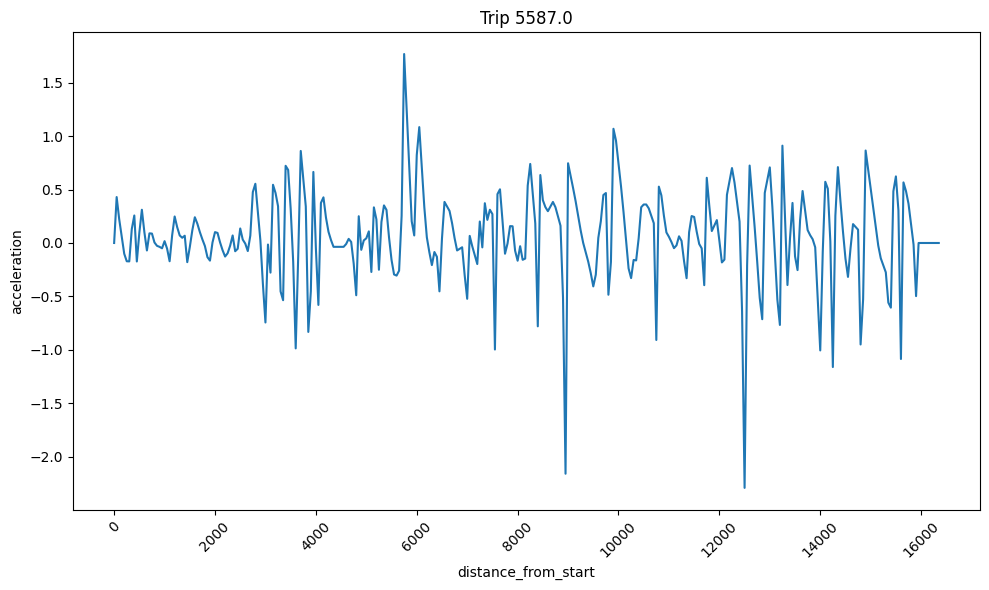

In [50]:
columnx='distance_from_start'
columny='acceleration'

trip_df = interpolated_dataframes[1]
plt.figure(figsize=(10, 6))  # Adjust figure size as needed
plt.plot(trip_df[f"{columnx}"], trip_df[f"{columny}"])
plt.xlabel(f"{columnx}")
plt.ylabel(f"{columny}")
plt.title("Trip " + str(trip_id))
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
plt.tight_layout()  # Adjust layout for better formatting
plt.show()

In [51]:
interpolated_dataframes[23]

,distance_from_start,radial_acceleration,speed,acceleration,acceleration_der,bus_stop,segment
0,0.0,0.000000,0.000000,0.000000,0.000000,0,1.0
1,50.0,0.030014,5.661390,0.290152,0.020797,0,1.0
2,100.0,0.051443,6.444581,0.081300,-0.017492,0,1.0
3,150.0,0.699868,7.949785,0.130806,-0.004822,0,1.0
4,200.0,1.160907,9.179270,0.148199,0.003809,0,1.0
...,...,...,...,...,...,...,...
323,16150.0,0.000000,0.000000,0.000000,0.000000,BT02,0.0
324,16200.0,0.000000,0.000000,0.000000,0.000000,BT02,0.0
325,16250.0,0.000000,0.000000,0.000000,0.000000,BT02,0.0
326,16300.0,0.000000,0.000000,0.000000,0.000000,BT02,0.0


In [52]:
len(interpolated_dataframes[1])

328

In [53]:
# get the number of columns in dataframes_without_trip_id
num_columns = len(interpolated_dataframes[0].columns)
num_columns

7

In [54]:
# get a list of column names in interpolated_dataframes
column_namesInter = interpolated_dataframes[1].columns
#make it to a string list of names 
column_namesInter = column_namesInter.tolist()
column_namesInter

['distance_from_start',
 'radial_acceleration',
 'speed',
 'acceleration',
 'acceleration_der',
 'bus_stop',
 'segment']

In [55]:
interpolated_dataframes[1]

,distance_from_start,radial_acceleration,speed,acceleration,acceleration_der,bus_stop,segment
0,0.0,0.000000,0.000000,0.000000,0.000000,0,1.0
1,50.0,0.063186,7.379934,0.429510,0.047341,0,1.0
2,100.0,0.087689,9.305577,0.224109,-0.007432,0,1.0
3,150.0,0.279162,9.204460,0.059873,-0.018055,0,1.0
4,200.0,0.525762,8.043311,-0.100376,-0.016042,0,1.0
...,...,...,...,...,...,...,...
323,16150.0,0.000000,0.000000,0.000000,0.000000,BT02,0.0
324,16200.0,0.000000,0.000000,0.000000,0.000000,BT02,0.0
325,16250.0,0.000000,0.000000,0.000000,0.000000,BT02,0.0
326,16300.0,0.000000,0.000000,0.000000,0.000000,BT02,0.0


In [56]:
# pip install h5py

#### TimeSeriesKMeans

In [57]:
# craete a newdata frame list by removing bus_stop and segment columns from each df in interpolated_dataframes , but keep the originl dataframes in interpolated_dataframes unchanged
df_for_tsc=[]
for df in interpolated_dataframes:
    df=df.drop(['bus_stop','segment'], axis=1)
    df_for_tsc.append(df)


In [58]:
df_for_tsc[1]

,distance_from_start,radial_acceleration,speed,acceleration,acceleration_der
0,0.0,0.000000,0.000000,0.000000,0.000000
1,50.0,0.063186,7.379934,0.429510,0.047341
2,100.0,0.087689,9.305577,0.224109,-0.007432
3,150.0,0.279162,9.204460,0.059873,-0.018055
4,200.0,0.525762,8.043311,-0.100376,-0.016042
...,...,...,...,...,...
323,16150.0,0.000000,0.000000,0.000000,0.000000
324,16200.0,0.000000,0.000000,0.000000,0.000000
325,16250.0,0.000000,0.000000,0.000000,0.000000
326,16300.0,0.000000,0.000000,0.000000,0.000000


In [59]:
# import numpy as np
# import matplotlib.pyplot as plt
# from tslearn.clustering import TimeSeriesKMeans
# from tslearn.preprocessing import TimeSeriesScalerMeanVariance, TimeSeriesResampler

# # Convert your list of dataframes to a 3D numpy array
# n_ts = len(df_for_tsc)
# sz = df_for_tsc[0].shape[0]
# d = df_for_tsc[0].shape[1]
# data_3d = np.array([df.values for df in df_for_tsc])

# # Perform preprocessing on the data
# X_train = TimeSeriesScalerMeanVariance().fit_transform(data_3d)
# X_train = TimeSeriesResampler(sz=sz).fit_transform(X_train)
# sz = X_train.shape[1]

# # Initialize lists to store inertia values for different cluster counts
# inertia_values = []

# # Define a range of cluster counts to test
# cluster_range = range(1, 12)  # You can adjust the range as needed
# seed = 1234
# # Calculate inertia for different cluster counts
# for cluster_count in cluster_range:
#     km = TimeSeriesKMeans(n_clusters=cluster_count,
#                           n_init=4,
#                           verbose=False,
#                           max_iter_barycenter=24,
#                           random_state=seed,
#                           n_jobs=-1)
#     km.fit(X_train)
#     inertia_values.append(km.inertia_)

# # Plot the elbow graph
# plt.figure(figsize=(8, 6))
# plt.plot(cluster_range, inertia_values, marker='o', linestyle='-')
# plt.title('Elbow Method for Optimal Cluster Count')
# plt.xlabel('Number of Clusters')
# plt.ylabel('Inertia')
# plt.grid(True)
# plt.show()


In [60]:
import numpy as np
import matplotlib.pyplot as plt
from tslearn.clustering import TimeSeriesKMeans
from tslearn.preprocessing import TimeSeriesScalerMeanVariance, TimeSeriesResampler

# Convert your list of dataframes to a 3D numpy array
n_ts = len(df_for_tsc)
sz = df_for_tsc[0].shape[0]
d = df_for_tsc[0].shape[1]
data_3d = np.array([df.values for df in df_for_tsc])

# Perform preprocessing on the data
X_train = TimeSeriesScalerMeanVariance().fit_transform(data_3d)
X_train = TimeSeriesResampler(sz=sz).fit_transform(X_train)
sz = X_train.shape[1]

# Perform TimeSeriesKMeans clustering
cluster_count = 4
seed = 1234
km = TimeSeriesKMeans(n_clusters=cluster_count,
                          n_init=4,
                        #   metric="dtw",
                          verbose=True,
                          max_iter_barycenter=24,
                          random_state=seed,
                          n_jobs=-1)
y_pred = km.fit_predict(X_train)



Init 1
1707.877 --> 880.856 --> 873.386 --> 872.558 --> 872.128 --> 871.960 --> 871.871 --> 871.821 --> 871.798 --> 871.779 --> 871.772 --> 871.768 --> 871.766 --> 871.765 --> 871.765 --> 
Init 2
1632.357 --> 874.887 --> 872.179 --> 871.917 --> 871.833 --> 871.796 --> 871.779 --> 871.772 --> 871.765 --> 871.764 --> 871.764 --> 
Init 3
1641.063 --> 878.916 --> 874.208 --> 872.780 --> 872.237 --> 871.927 --> 871.802 --> 871.758 --> 871.739 --> 871.737 --> 871.737 --> 
Init 4
1682.703 --> 900.439 --> 889.595 --> 881.291 --> 875.724 --> 873.560 --> 872.925 --> 872.459 --> 872.052 --> 871.912 --> 871.842 --> 871.809 --> 871.779 --> 871.772 --> 871.765 --> 871.764 --> 871.764 --> 


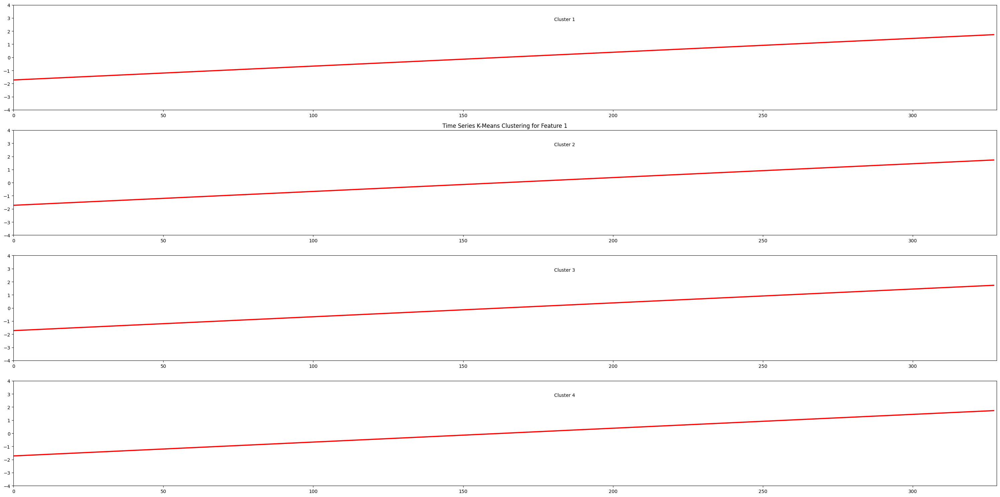

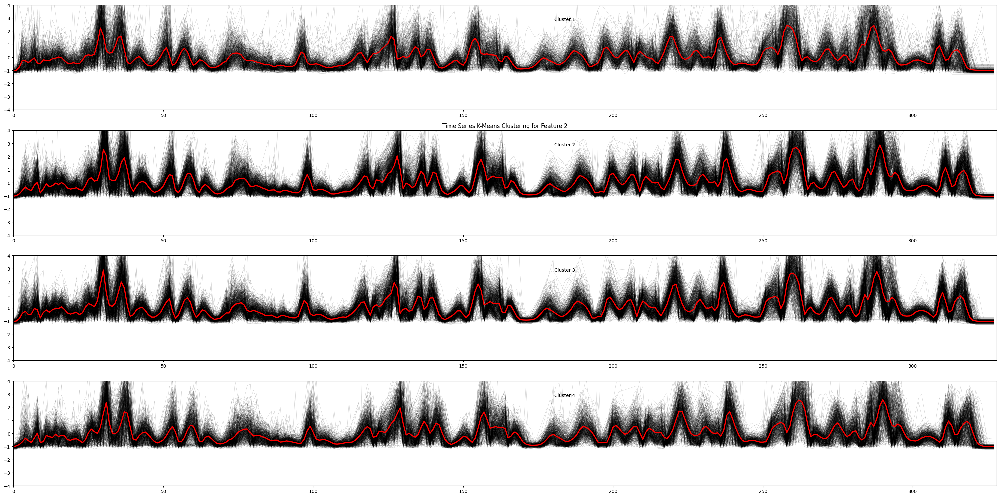

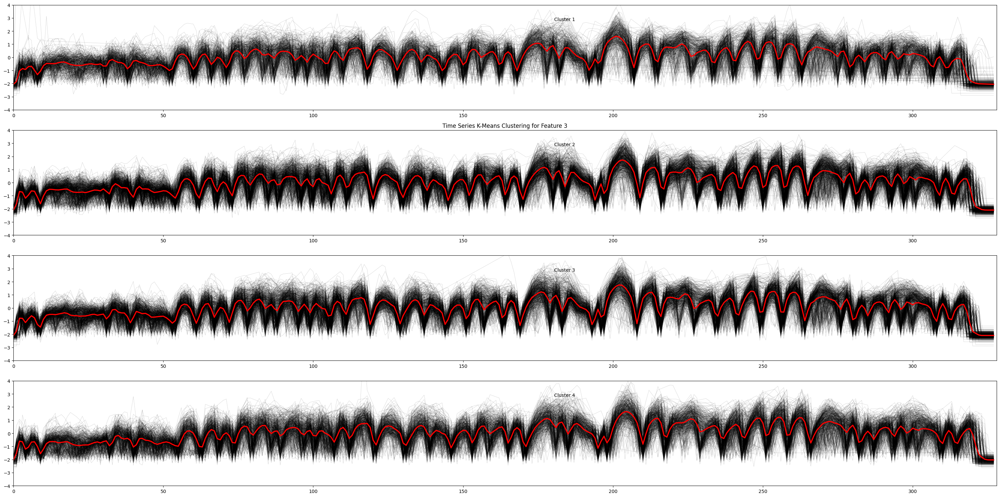

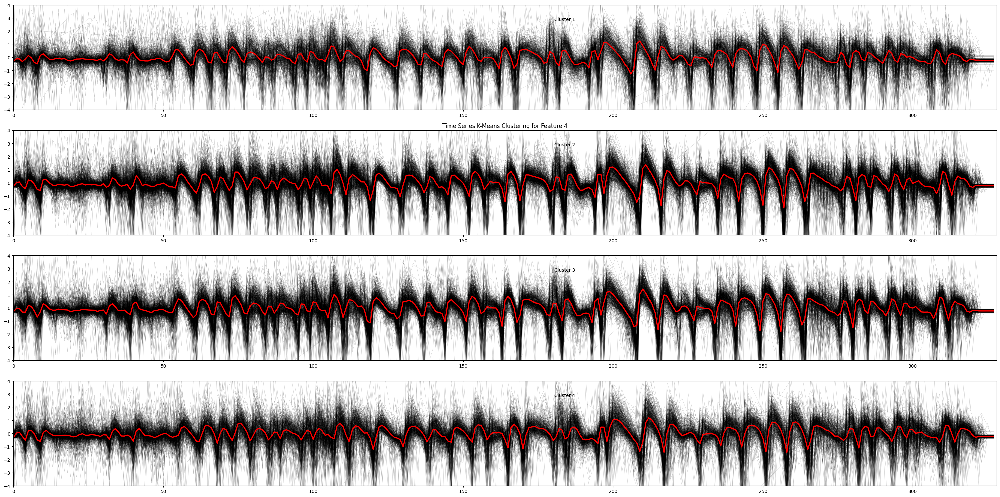

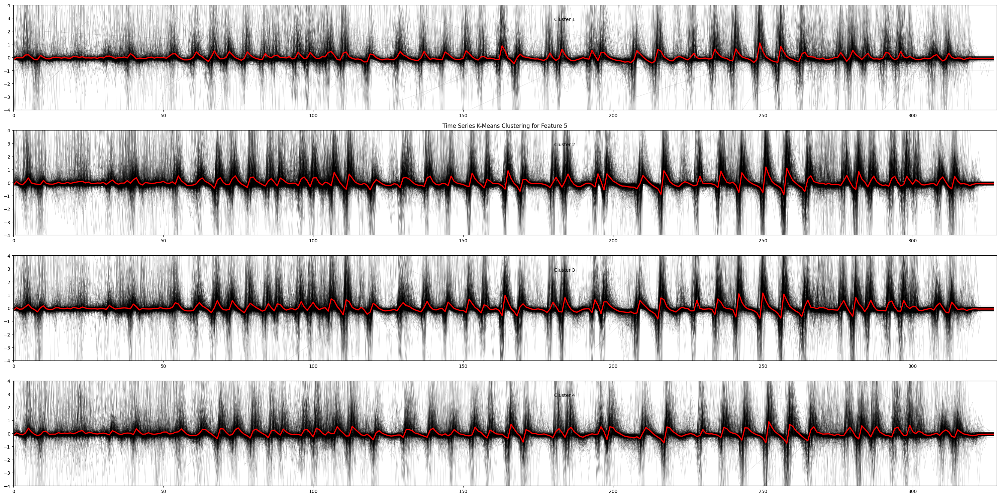

In [61]:
from tslearn.barycenters import dtw_barycenter_averaging

# Iterate through each feature and visualize the clusters
for feature_idx in range(X_train.shape[2]):
    plt.figure(figsize=(30, 15))
    for yi in range(cluster_count):
        plt.subplot(cluster_count, 1, yi + 1)
        for xx in X_train[y_pred == yi, :, feature_idx]:
            plt.plot(xx.ravel(), "k-", alpha=0.2,linewidth=0.5)
        plt.plot(km.cluster_centers_[yi, :, feature_idx].ravel(), "r-", linewidth=2.5)  # Adjust linewidth as needed
        plt.xlim(0, sz)
        plt.ylim(-4, 4)
        plt.text(0.55, 0.85, f'Cluster {yi + 1}', transform=plt.gca().transAxes)
        if yi == 1:
            plt.title(f"Time Series K-Means Clustering for Feature {feature_idx + 1}")
    plt.tight_layout()
    plt.show()


#### TimeSeries DBScan

In [62]:
df_for_tsc[2]

,distance_from_start,radial_acceleration,speed,acceleration,acceleration_der
0,0.0,0.000000,0.000000,0.000000,0.000000
1,50.0,0.159154,6.243505,0.227452,0.020141
2,100.0,0.079918,6.384957,0.001122,-0.022289
3,150.0,0.022750,7.872240,0.125062,0.007457
4,200.0,0.001046,0.604531,-0.488907,-0.041297
...,...,...,...,...,...
323,16150.0,0.000000,0.000000,0.000000,0.000000
324,16200.0,0.000000,0.000000,0.000000,0.000000
325,16250.0,0.000000,0.000000,0.000000,0.000000
326,16300.0,0.000000,0.000000,0.000000,0.000000


In [63]:
processed_trip_ids[1]

4.0

In [64]:
df_for_tsc[1]

,distance_from_start,radial_acceleration,speed,acceleration,acceleration_der
0,0.0,0.000000,0.000000,0.000000,0.000000
1,50.0,0.063186,7.379934,0.429510,0.047341
2,100.0,0.087689,9.305577,0.224109,-0.007432
3,150.0,0.279162,9.204460,0.059873,-0.018055
4,200.0,0.525762,8.043311,-0.100376,-0.016042
...,...,...,...,...,...
323,16150.0,0.000000,0.000000,0.000000,0.000000
324,16200.0,0.000000,0.000000,0.000000,0.000000
325,16250.0,0.000000,0.000000,0.000000,0.000000
326,16300.0,0.000000,0.000000,0.000000,0.000000


In [65]:
# iterate through each dataframes in df_for_tsc and add a new column 'trip id' to each dataframe and concatanate the new dataframes in to a one dataframe
concatenated_df=pd.DataFrame()
for index, df in enumerate(df_for_tsc):
    df['trip_id']=processed_trip_ids[index]
    concatenated_df = pd.concat([concatenated_df, df], axis=0, ignore_index=True)

In [66]:
concatenated_df

,distance_from_start,radial_acceleration,speed,acceleration,acceleration_der,trip_id
0,0.0,0.000000,0.000000,0.000000,0.000000,2.0
1,50.0,0.000000,0.000000,0.000000,0.000000,2.0
2,100.0,0.000000,0.000000,0.000000,0.000000,2.0
3,150.0,0.906742,8.455379,-0.203879,-0.009536,2.0
4,200.0,0.207992,4.675092,-0.234925,-0.002526,2.0
...,...,...,...,...,...,...
775715,16150.0,0.000000,0.000000,0.000000,0.000000,5583.0
775716,16200.0,0.000000,0.000000,0.000000,0.000000,5583.0
775717,16250.0,0.000000,0.000000,0.000000,0.000000,5583.0
775718,16300.0,0.000000,0.000000,0.000000,0.000000,5583.0


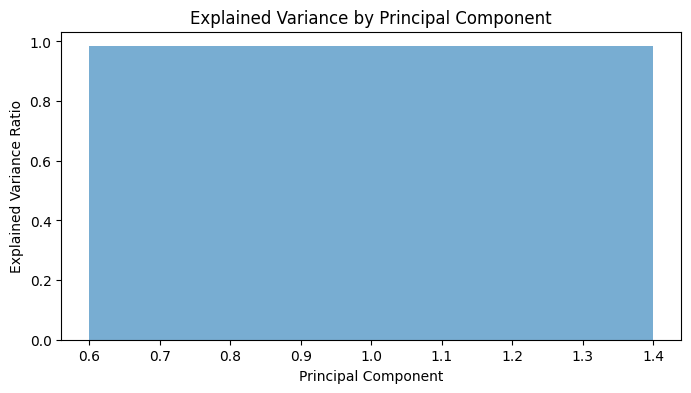

Principal Component 1: Explained Variance = 0.9833


In [67]:
from sklearn.decomposition import PCA

features = ['radial_acceleration', 'speed', 'acceleration', 'acceleration_der']
input_dataframe = concatenated_df[features].copy()

# Calculate PCA
pca = PCA(n_components=1)
pca_components = pca.fit_transform(input_dataframe)  # Use fit_transform here

# Create a DataFrame for the PCA components
pca_df = pd.DataFrame(data=pca_components, columns=['PCA1'])

# Get explained variance ratios
explained_variance_ratios = pca.explained_variance_ratio_

# Visualize explained variance ratios
plt.figure(figsize=(8, 4))
plt.bar(range(1, len(explained_variance_ratios) + 1), explained_variance_ratios, alpha=0.6, align='center')
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance by Principal Component')
plt.show()

# Print explained variance ratios
for i, explained_variance in enumerate(explained_variance_ratios):
    print(f'Principal Component {i + 1}: Explained Variance = {explained_variance:.4f}')


In [68]:
pca_df

,PCA1
0,-12.574221
1,-12.574221
2,-12.574221
3,-4.093497
4,-7.903898
...,...
775715,-12.574221
775716,-12.574221
775717,-12.574221
775718,-12.574221


In [69]:
concatenated_df

,distance_from_start,radial_acceleration,speed,acceleration,acceleration_der,trip_id
0,0.0,0.000000,0.000000,0.000000,0.000000,2.0
1,50.0,0.000000,0.000000,0.000000,0.000000,2.0
2,100.0,0.000000,0.000000,0.000000,0.000000,2.0
3,150.0,0.906742,8.455379,-0.203879,-0.009536,2.0
4,200.0,0.207992,4.675092,-0.234925,-0.002526,2.0
...,...,...,...,...,...,...
775715,16150.0,0.000000,0.000000,0.000000,0.000000,5583.0
775716,16200.0,0.000000,0.000000,0.000000,0.000000,5583.0
775717,16250.0,0.000000,0.000000,0.000000,0.000000,5583.0
775718,16300.0,0.000000,0.000000,0.000000,0.000000,5583.0


In [70]:
pca_df_for_tsp = pd.concat([concatenated_df[['trip_id', 'distance_from_start']], pca_df], axis=1)


In [71]:
pca_df_for_tsp

,trip_id,distance_from_start,PCA1
0,2.0,0.0,-12.574221
1,2.0,50.0,-12.574221
2,2.0,100.0,-12.574221
3,2.0,150.0,-4.093497
4,2.0,200.0,-7.903898
...,...,...,...
775715,5583.0,16150.0,-12.574221
775716,5583.0,16200.0,-12.574221
775717,5583.0,16250.0,-12.574221
775718,5583.0,16300.0,-12.574221


In [72]:
pca_dfs = []

for trip_id in processed_trip_ids:
    trip_pca_df = pca_df_for_tsp[pca_df_for_tsp['trip_id'] == trip_id][['distance_from_start', 'PCA1']]
    trip_pca_df = trip_pca_df.reset_index(drop=True)  # Reset the index
    pca_dfs.append(trip_pca_df)


In [73]:
pca_dfs[1]

,distance_from_start,PCA1
0,0.0,-12.574221
1,50.0,-5.191350
2,100.0,-3.273938
3,150.0,-3.369980
4,200.0,-4.521247
...,...,...
323,16150.0,-12.574221
324,16200.0,-12.574221
325,16250.0,-12.574221
326,16300.0,-12.574221


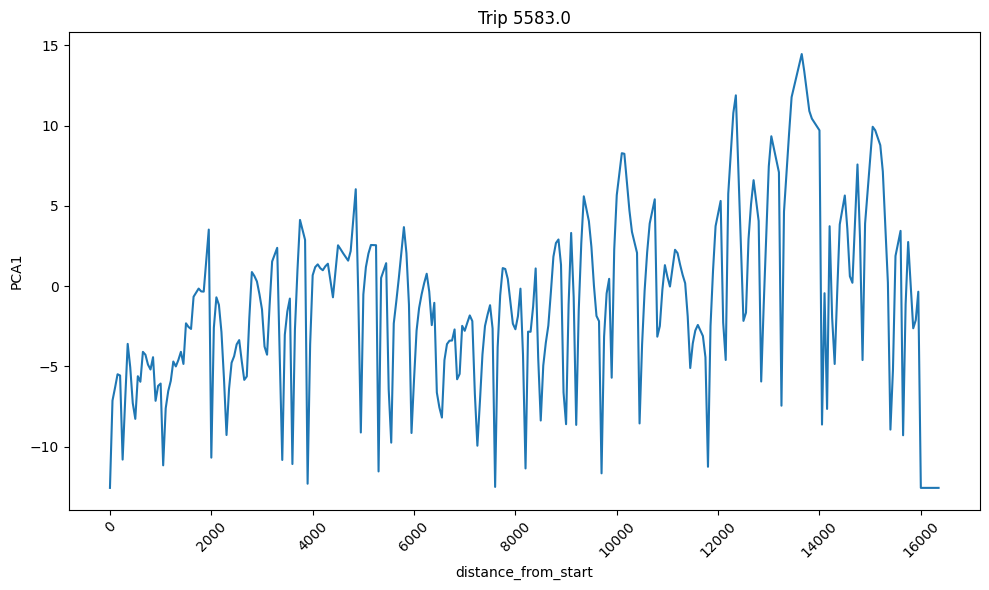

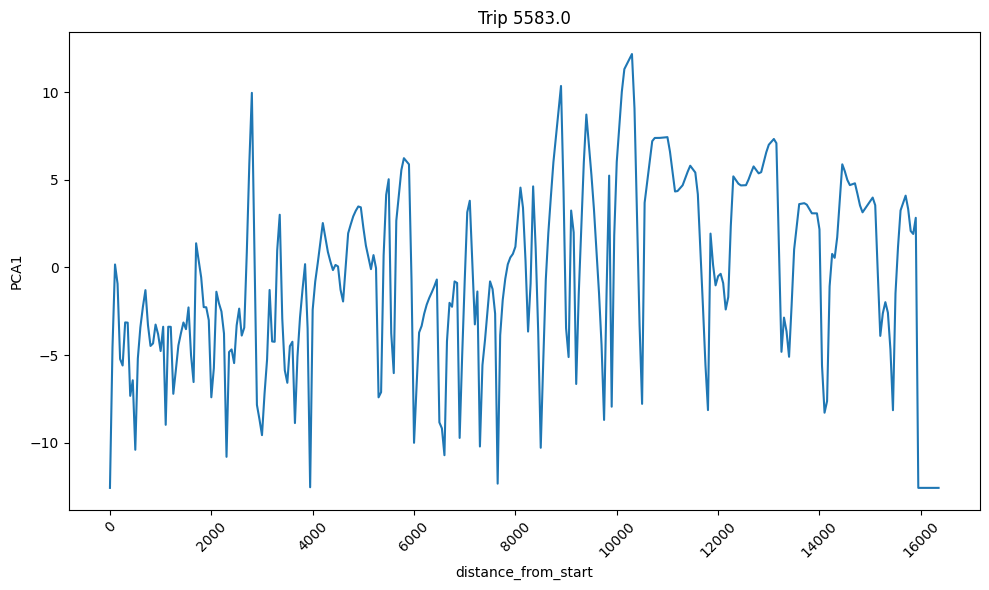

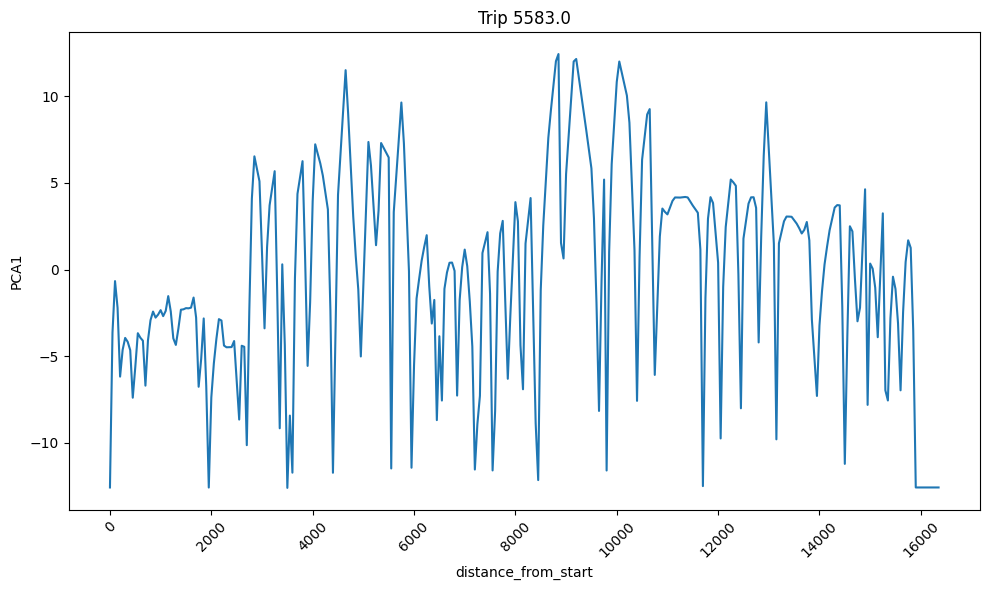

In [74]:
columnx='distance_from_start'
columny='PCA1'



def draw_linechart(trip_df,columnx,columny):
    plt.figure(figsize=(10, 6))  # Adjust figure size as needed
    plt.plot(trip_df[f"{columnx}"], trip_df[f"{columny}"])
    plt.xlabel(f"{columnx}")
    plt.ylabel(f"{columny}")
    plt.title("Trip " + str(trip_id))
    plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
    plt.tight_layout()  # Adjust layout for better formatting
    plt.show()
    
for i in [4,8,12]:
    draw_linechart(pca_dfs[i],columnx,columny)

In [120]:
import numpy as np
import matplotlib.pyplot as plt
from tslearn.clustering import TimeSeriesKMeans
from tslearn.preprocessing import TimeSeriesScalerMeanVariance, TimeSeriesResampler

# Convert your list of dataframes to a 3D numpy array
n_ts = len(pca_dfs)
sz = pca_dfs[0].shape[0]
d = pca_dfs[0].shape[1]
data_3d = np.array([df.values for df in pca_dfs])

# Perform preprocessing on the data
X_train = TimeSeriesScalerMeanVariance().fit_transform(data_3d)
X_train = TimeSeriesResampler(sz=sz).fit_transform(X_train)
sz = X_train.shape[1]

# Perform TimeSeriesKMeans clustering
cluster_count = 4
seed = 1234
km = TimeSeriesKMeans(n_clusters=cluster_count,
                          n_init=4,
                        #   metric="dtw",
                          verbose=True,
                          max_iter_barycenter=24,
                          random_state=seed,
                          n_jobs=-1)
y_pred = km.fit_predict(X_train)

Init 1
310.836 --> 170.975 --> 168.192 --> 167.459 --> 166.979 --> 166.637 --> 166.396 --> 166.246 --> 166.145 --> 166.064 --> 166.032 --> 166.019 --> 166.015 --> 166.010 --> 166.007 --> 166.004 --> 166.001 --> 165.998 --> 165.994 --> 165.986 --> 165.981 --> 165.979 --> 165.977 --> 165.976 --> 165.974 --> 165.971 --> 165.968 --> 165.965 --> 165.964 --> 165.964 --> 165.964 --> 
Init 2
305.827 --> 172.457 --> 168.257 --> 166.244 --> 166.034 --> 166.013 --> 166.006 --> 166.004 --> 166.002 --> 165.999 --> 165.995 --> 165.988 --> 165.983 --> 165.981 --> 165.979 --> 165.977 --> 165.975 --> 165.972 --> 165.970 --> 165.968 --> 165.966 --> 165.965 --> 165.965 --> 165.964 --> 165.964 --> 
Init 3
303.066 --> 168.263 --> 166.771 --> 166.256 --> 166.106 --> 166.063 --> 166.032 --> 165.997 --> 165.982 --> 165.976 --> 165.971 --> 165.968 --> 165.964 --> 165.963 --> 165.960 --> 165.959 --> 165.958 --> 165.957 --> 165.956 --> 165.954 --> 165.953 --> 165.952 --> 165.952 --> 165.952 --> 
Init 4
290.538 -

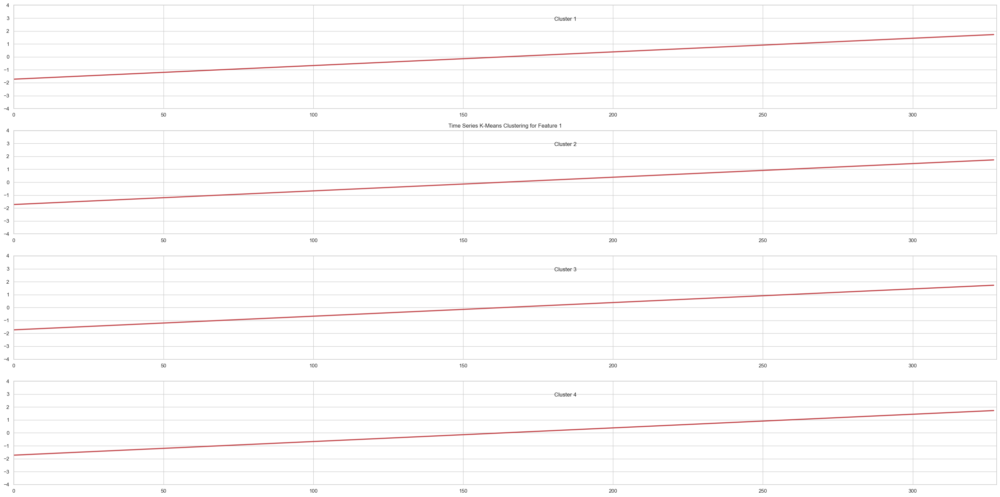

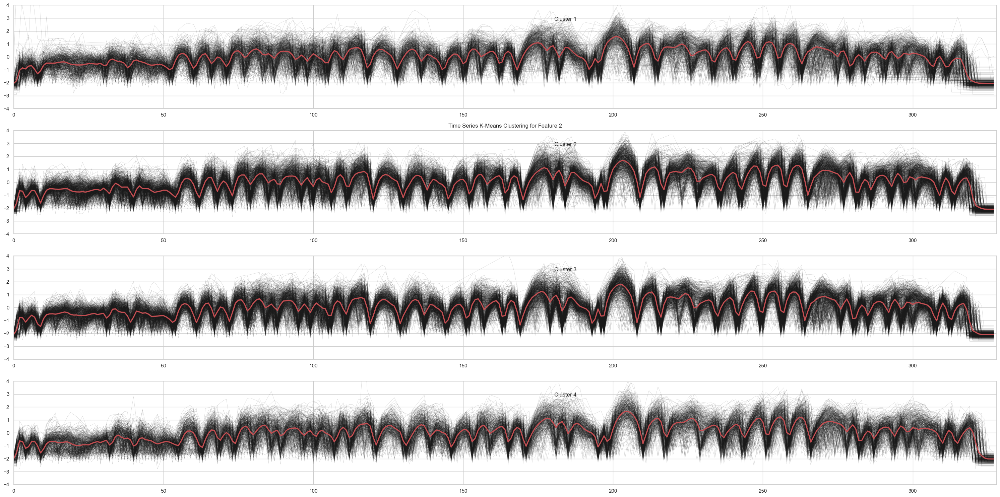

In [121]:
from tslearn.barycenters import dtw_barycenter_averaging

# Iterate through each feature and visualize the clusters
for feature_idx in range(X_train.shape[2]):
    plt.figure(figsize=(30, 15))
    for yi in range(cluster_count):
        plt.subplot(cluster_count, 1, yi + 1)
        for xx in X_train[y_pred == yi, :, feature_idx]:
            plt.plot(xx.ravel(), "k-", alpha=0.2,linewidth=0.5)
        plt.plot(km.cluster_centers_[yi, :, feature_idx].ravel(), "r-", linewidth=2.5)  # Adjust linewidth as needed
        plt.xlim(0, sz)
        plt.ylim(-4, 4)
        plt.text(0.55, 0.85, f'Cluster {yi + 1}', transform=plt.gca().transAxes)
        if yi == 1:
            plt.title(f"Time Series K-Means Clustering for Feature {feature_idx + 1}")
    plt.tight_layout()
    plt.show()


In [124]:

# Create an empty DataFrame to store the combined data
combined_df = pd.DataFrame()

# Iterate through the list of DataFrames
for idx, df in enumerate(pca_dfs):
    # Add a new column 'Index' with the index of the corresponding DataFrame
    df['Index'] = idx
    
    # Pivot the DataFrame to convert 'distance_from_start' values into columns
    pivoted_df = df.pivot(index='Index', columns='distance_from_start', values='PCA1')
    
    # Concatenate the pivoted DataFrame with the combined_df
    combined_df = pd.concat([combined_df, pivoted_df], axis=1)

# Reset the index of the combined DataFrame
combined_df.reset_index(drop=True, inplace=True)

# Fill any missing values (NaN) with 0
combined_df.fillna(0, inplace=True)

# Now, 'combined_df' contains the desired structure with the index of each DataFrame and 'distance_from_start' values as columns
print(combined_df)


distance_from_start    0.0        50.0       100.0     150.0     200.0    \
0                   -12.574221 -12.574221 -12.574221 -4.093497 -7.903898   
1                     0.000000   0.000000   0.000000  0.000000  0.000000   
2                     0.000000   0.000000   0.000000  0.000000  0.000000   
3                     0.000000   0.000000   0.000000  0.000000  0.000000   
4                     0.000000   0.000000   0.000000  0.000000  0.000000   
...                        ...        ...        ...       ...       ...   
2360                  0.000000   0.000000   0.000000  0.000000  0.000000   
2361                  0.000000   0.000000   0.000000  0.000000  0.000000   
2362                  0.000000   0.000000   0.000000  0.000000  0.000000   
2363                  0.000000   0.000000   0.000000  0.000000  0.000000   
2364                  0.000000   0.000000   0.000000  0.000000  0.000000   

distance_from_start   250.0     300.0     350.0      400.0    450.0    ...  \
0        

In [133]:
combined_df[50.0]

distance_from_start,50.0,50.0,50.0,50.0,50.0,50.0,50.0,50.0,50.0,50.0,...,50.0,50.0,50.0,50.0,50.0,50.0,50.0,50.0,50.0,50.0
0,-12.574221,0.00000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
1,0.000000,-5.19135,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
2,0.000000,0.00000,-6.326856,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
3,0.000000,0.00000,0.000000,-12.574221,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
4,0.000000,0.00000,0.000000,0.000000,-7.134717,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2360,0.000000,0.00000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,-12.574221,0.000000,0.000000,0.000000,0.000000
2361,0.000000,0.00000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,-12.574221,0.000000,0.000000,0.000000
2362,0.000000,0.00000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,-12.574221,0.000000,0.000000
2363,0.000000,0.00000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,-12.574221,0.000000


In [126]:
# save csv file
combined_df.to_csv('../DataOut/df_for_dbscan.csv', index=False)

In [134]:
# import ../DataOut/df_for_dbscan.csv csv
df_for_dbscan = pd.read_csv("../DataOut/df_for_dbscan.csv")

MemoryError: 

In [128]:
import pandas as pd
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# Create a sample DataFrame with two features (X and Y)
data = combined_df

df = pd.DataFrame(data)

# # Standardize the features (important for DBSCAN)
# scaler = StandardScaler()
# df[['X', 'Y']] = scaler.fit_transform(df[['X', 'Y']])

# Initialize and fit the DBSCAN model
eps = 0.5  # The maximum distance between two samples for one to be considered as in the neighborhood of the other
min_samples = 2  # The number of samples (or total weight) in a neighborhood for a point to be considered as a core point.
dbscan = DBSCAN(eps=eps, min_samples=min_samples)
dbscan.fit(df)

# Get the cluster labels (-1 represents outliers)
cluster_labels = dbscan.labels_

# Visualize the clusters
plt.figure(figsize=(8, 6))
plt.scatter(df['X'], df['Y'], c=cluster_labels, cmap='viridis')
plt.xlabel('X')
plt.ylabel('Y')
plt.title('DBSCAN Clustering')
plt.show()

# Print the cluster labels
print("Cluster Labels:")
print(cluster_labels)

# Number of clusters formed (excluding outliers, labeled as -1)
n_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
print(f"Number of clusters: {n_clusters}")


KeyboardInterrupt: 

In [77]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
from tslearn.preprocessing import TimeSeriesScalerMeanVariance, TimeSeriesResampler

# Assuming X_train is your preprocessed time series data
X_train = TimeSeriesScalerMeanVariance().fit_transform(data_3d)
X_train = TimeSeriesResampler(sz=sz).fit_transform(X_train)

# Flatten the 3D data to 2D
X_train_2d = X_train.reshape(X_train.shape[0], -1)

# Perform DBSCAN clustering
dbscan = DBSCAN(eps=0.5, min_samples=5, metric='euclidean')
y_predDB = dbscan.fit_predict(X_train_2d)

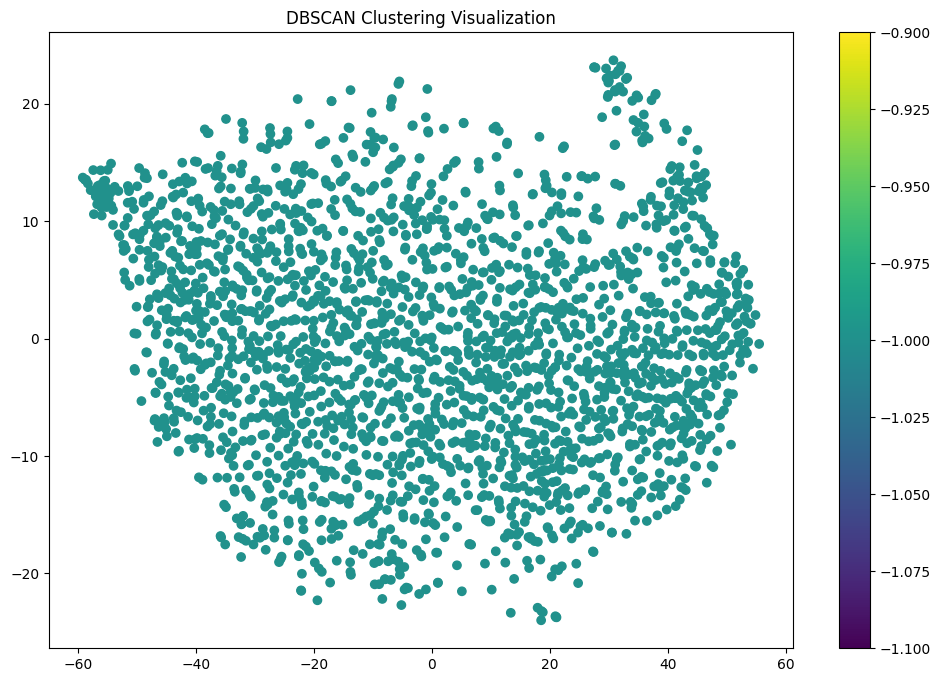

In [78]:
# The code snippet is performing DBSCAN (Density-Based Spatial Clustering of Applications with Noise) clustering on time series data. Here is a breakdown of what each step does:
from sklearn.manifold import TSNE

# Apply t-SNE to reduce dimensionality for visualization
tsne = TSNE(n_components=2)
X_tsne = tsne.fit_transform(X_train.reshape(X_train.shape[0], -1))

# Create a scatter plot for the clusters
plt.figure(figsize=(12, 8))
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=y_predDB, cmap='viridis')
plt.title('DBSCAN Clustering Visualization')
plt.colorbar()
plt.show()


### Cluster data Visualize

In [79]:
# convert processed_trip_ids to a numpy array
processed_trip_ids = np.array(processed_trip_ids)

In [80]:
# create a data frame from processed_trip_ids and y_pred , and rename the columns to 'trip_id' and 'cluster'
trip_clusters = pd.DataFrame({'trip_id': processed_trip_ids, 'TScluster': y_pred})

In [81]:
trip_clusters

,trip_id,TScluster
0,2.0,0
1,4.0,2
2,6.0,3
3,8.0,2
4,10.0,1
...,...,...
2360,5569.0,0
2361,5572.0,2
2362,5574.0,3
2363,5581.0,3


In [82]:
datain_one_direction

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration,radial_acceleration,distance_from_start,time_diff,acc_diff,acceleration_der
0,574733100,116,2021-10-16 08:03:34,7.293043,80.637552,10.25920,2021-10-16,08:03:34,POINT (184964.84865244984 232317.35306792473),0,2.0,1,-0.251980,1.278067,123.738485,0 days 00:00:15,-0.575955,-0.038397
1,574733101,116,2021-10-16 08:03:49,7.292725,80.637707,7.55940,2021-10-16,08:03:49,POINT (184981.95255171193 232282.14959255166),0,2.0,1,-0.179987,0.722300,163.044397,0 days 00:00:15,0.071993,0.004800
2,574733102,116,2021-10-16 08:04:04,7.292292,80.637663,3.77970,2021-10-16,08:04:04,POINT (184977.15733984314 232234.22458233108),0,2.0,1,-0.251980,0.048332,211.472339,0 days 00:00:15,-0.071993,-0.004800
3,574736662,116,2021-10-16 08:04:19,7.291640,80.637455,9.17927,2021-10-16,08:04:19,POINT (184954.1363920236 232162.16484193364),101,2.0,1,0.359971,1.052222,287.492821,0 days 00:00:15,0.611951,0.040797
4,574736663,116,2021-10-16 08:04:34,7.291210,80.637713,8.63931,2021-10-16,08:04:34,POINT (184982.64260533327 232114.61697960715),101,2.0,1,-0.035997,0.639311,343.141212,0 days 00:00:15,-0.395969,-0.026398
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
624811,1310920500,262,2022-08-09 13:55:01,7.297083,80.733067,2.15983,2022-08-09,13:55:01,POINT (195511.17515211075 232762.08627614228),0,5587.0,1,-0.057853,0.017268,16959.169925,0 days 00:00:28,-0.417826,-0.014922
624812,1310920499,262,2022-08-09 13:55:36,7.297722,80.734413,2.15983,2022-08-09,13:55:36,POINT (195659.87537883484 232832.65837385712),0,5587.0,1,0.000000,0.050073,17123.789768,0 days 00:00:35,0.057853,0.001653
624813,1310920498,262,2022-08-09 13:55:37,7.297892,80.733978,2.69978,2022-08-09,13:55:37,POINT (195611.8469759471 232851.46134159045),0,5587.0,1,0.539950,0.056444,17175.357332,0 days 00:00:01,0.539950,0.539950
624814,1310920497,262,2022-08-09 13:55:41,7.297452,80.732843,5.39957,2022-08-09,13:55:41,POINT (195486.52323854627 232802.8158163402),0,5587.0,1,0.674947,0.062833,17309.762484,0 days 00:00:04,0.134997,0.033749


In [83]:
data_with_clusters

,speed,acceleration,radial_acceleration,acceleration_der,cluster,deviceid,trip_id
0,10.25920,-0.251980,1.278067,-0.038397,1,116,2.0
1,7.55940,-0.179987,0.722300,0.004800,0,116,2.0
2,3.77970,-0.251980,0.048332,-0.004800,0,116,2.0
3,9.17927,0.359971,1.052222,0.040797,1,116,2.0
4,8.63931,-0.035997,0.639311,-0.026398,0,116,2.0
...,...,...,...,...,...,...,...
624811,2.15983,-0.057853,0.017268,-0.014922,3,262,5587.0
624812,2.15983,0.000000,0.050073,0.001653,3,262,5587.0
624813,2.69978,0.539950,0.056444,0.539950,0,262,5587.0
624814,5.39957,0.674947,0.062833,0.033749,0,262,5587.0


In [84]:
norm_clusters=pd.DataFrame({'trip_id': data_with_clusters['trip_id'], 'NormCluster': data_with_clusters['cluster']})

In [85]:
norm_clusters

,trip_id,NormCluster
0,2.0,1
1,2.0,0
2,2.0,0
3,2.0,1
4,2.0,0
...,...,...
624811,5587.0,3
624812,5587.0,3
624813,5587.0,0
624814,5587.0,0


In [86]:
from scipy import stats

norm_clusters = norm_clusters.groupby('trip_id')['NormCluster'].apply(lambda x: stats.mode(x)[0][0]).reset_index()
norm_clusters

C:\Users\gw\AppData\Local\Temp\ipykernel_28996\2383350003.py:3: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  norm_clusters = norm_clusters.groupby('trip_id')['NormCluster'].apply(lambda x: stats.mode(x)[0][0]).reset_index()


,trip_id,NormCluster
0,2.0,1
1,4.0,1
2,6.0,1
3,8.0,1
4,10.0,1
...,...,...
2731,5579.0,0
2732,5581.0,1
2733,5583.0,0
2734,5585.0,0


In [1]:
trip_clusters

NameError: name 'trip_clusters' is not defined

In [87]:
cluster_data = pd.DataFrame()

cluster_data = datain_one_direction[['trip_id', 'deviceid', 'speed', 'acceleration', 'radial_acceleration', 'distance_from_start']]

# Perform a left merge based on 'trip_id'
cluster_data = pd.merge(cluster_data, trip_clusters, on='trip_id', how='left')

cluster_data = pd.merge(cluster_data, norm_clusters, on='trip_id', how='left')

In [88]:
cluster_data

,trip_id,deviceid,speed,acceleration,radial_acceleration,distance_from_start,TScluster,NormCluster
0,2.0,116,10.25920,-0.251980,1.278067,123.738485,0.0,1
1,2.0,116,7.55940,-0.179987,0.722300,163.044397,0.0,1
2,2.0,116,3.77970,-0.251980,0.048332,211.472339,0.0,1
3,2.0,116,9.17927,0.359971,1.052222,287.492821,0.0,1
4,2.0,116,8.63931,-0.035997,0.639311,343.141212,0.0,1
...,...,...,...,...,...,...,...,...
624811,5587.0,262,2.15983,-0.057853,0.017268,16959.169925,NaN,0
624812,5587.0,262,2.15983,0.000000,0.050073,17123.789768,NaN,0
624813,5587.0,262,2.69978,0.539950,0.056444,17175.357332,NaN,0
624814,5587.0,262,5.39957,0.674947,0.062833,17309.762484,NaN,0


In [89]:
cluster_data.dropna(inplace=True)

In [90]:
cluster_data.groupby('trip_id').mean()

,deviceid,speed,acceleration,radial_acceleration,distance_from_start,TScluster,NormCluster
trip_id,,,,,,,
2.0,116.0,9.684988,-0.030312,0.486188,7446.001023,0.0,1.0
4.0,116.0,8.280105,-0.023150,0.403036,7481.777432,2.0,1.0
6.0,116.0,8.531324,-0.027055,0.423613,7615.913546,3.0,1.0
8.0,116.0,9.579717,-0.033700,0.528990,7180.085115,2.0,1.0
10.0,116.0,9.529990,-0.059761,0.472924,7182.280605,1.0,1.0
...,...,...,...,...,...,...,...
5569.0,262.0,7.867643,-0.252186,0.424686,7709.881684,0.0,1.0
5572.0,262.0,8.172791,-0.263417,0.436544,7530.481198,2.0,0.0
5574.0,262.0,7.476186,-0.405243,0.440879,6416.251639,3.0,0.0


In [91]:
data_with_clusters

,speed,acceleration,radial_acceleration,acceleration_der,cluster,deviceid,trip_id
0,10.25920,-0.251980,1.278067,-0.038397,1,116,2.0
1,7.55940,-0.179987,0.722300,0.004800,0,116,2.0
2,3.77970,-0.251980,0.048332,-0.004800,0,116,2.0
3,9.17927,0.359971,1.052222,0.040797,1,116,2.0
4,8.63931,-0.035997,0.639311,-0.026398,0,116,2.0
...,...,...,...,...,...,...,...
624811,2.15983,-0.057853,0.017268,-0.014922,3,262,5587.0
624812,2.15983,0.000000,0.050073,0.001653,3,262,5587.0
624813,2.69978,0.539950,0.056444,0.539950,0,262,5587.0
624814,5.39957,0.674947,0.062833,0.033749,0,262,5587.0


In [92]:
#Group by 'TScluster' and calculate the mean of each feature
TSclusgrped=cluster_data.groupby('TScluster').mean()


# #Group by 'NormCluster' and calculate the mean of each feature
NormClustGrped=cluster_data.groupby('NormCluster').mean()


In [93]:
TSclusgrped

,trip_id,deviceid,speed,acceleration,radial_acceleration,distance_from_start,NormCluster
TScluster,,,,,,,
0.0,2609.750699,139.803654,9.491945,-0.213216,0.504356,7423.883052,0.743353
1.0,2902.747776,162.165955,8.730293,-0.194123,0.455901,7407.574092,0.555435
2.0,2635.758963,146.509684,9.002193,-0.209161,0.467778,7506.074051,0.607315
3.0,3299.348553,178.144611,8.181315,-0.188802,0.436267,7060.433832,0.387409


In [94]:
NormClustGrped

,trip_id,deviceid,speed,acceleration,radial_acceleration,distance_from_start,TScluster
NormCluster,,,,,,,
0,3330.422478,163.994344,8.328407,-0.236691,0.442840,7201.597789,1.655197
1,2413.906888,150.764245,9.160155,-0.166420,0.471863,7571.900815,1.428407
2,2637.383786,141.704751,12.396478,-0.215116,0.698396,7319.302986,0.664760
3,745.657797,121.276128,7.805882,-0.064371,0.410141,6870.122020,1.625145


In [95]:
average_values

,speed,acceleration,radial_acceleration,acceleration_der,deviceid,trip_id
cluster,,,,,,
0,5.046115,0.225243,0.243741,0.277488,156.106487,2935.292147
1,12.715677,0.134497,0.699872,-0.008791,152.999063,2743.266506
2,20.182694,0.439315,1.059980,-0.000308,152.665651,2827.715571
3,0.058073,-1.827924,0.000781,-0.669439,154.169325,2798.800146


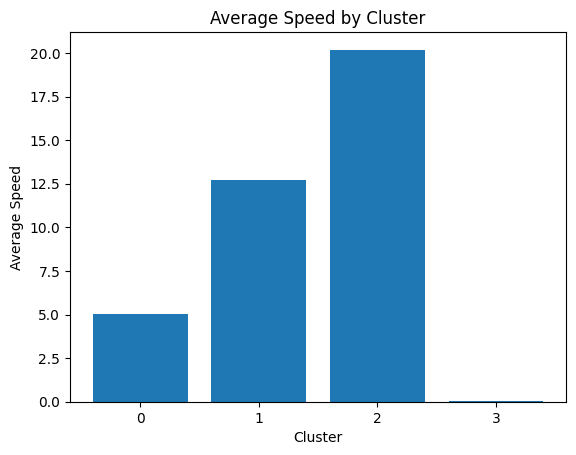

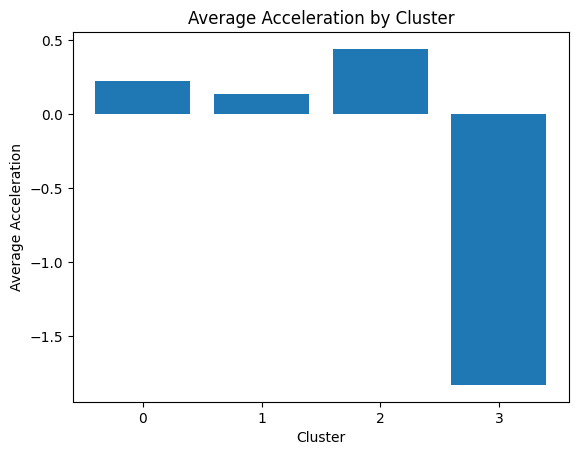

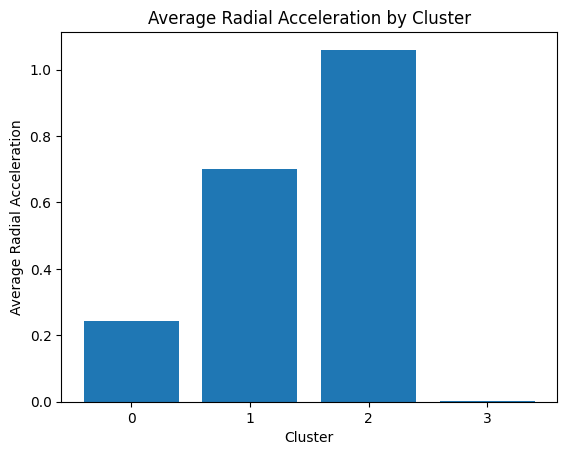

In [96]:
import matplotlib.pyplot as plt


# Calculate average values for each cluster
stat_vals = data_with_clusters.groupby('cluster').mean()

# stat_vals= cluster_data.groupby('TScluster').apply(lambda x: stats.mode(x)[0][0]).reset_index()

# stat_vals = cluster_data.groupby('TScluster').max().reset_index()



# Plot bar graph for Average Speed
plt.bar(stat_vals.index, stat_vals['speed'])
plt.xlabel('Cluster')
plt.ylabel('Average Speed')
plt.title('Average Speed by Cluster')
plt.xticks(stat_vals.index)
plt.show()

# Plot bar graph for Average Acceleration
plt.bar(stat_vals.index, stat_vals['acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Acceleration')
plt.title('Average Acceleration by Cluster')
plt.xticks(stat_vals.index)
plt.show()

# Plot bar graph for Average Radial Acceleration
plt.bar(stat_vals.index, stat_vals['radial_acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Radial Acceleration')
plt.title('Average Radial Acceleration by Cluster')
plt.xticks(stat_vals.index)
plt.show()

In [97]:
data_with_clusters

,speed,acceleration,radial_acceleration,acceleration_der,cluster,deviceid,trip_id
0,10.25920,-0.251980,1.278067,-0.038397,1,116,2.0
1,7.55940,-0.179987,0.722300,0.004800,0,116,2.0
2,3.77970,-0.251980,0.048332,-0.004800,0,116,2.0
3,9.17927,0.359971,1.052222,0.040797,1,116,2.0
4,8.63931,-0.035997,0.639311,-0.026398,0,116,2.0
...,...,...,...,...,...,...,...
624811,2.15983,-0.057853,0.017268,-0.014922,3,262,5587.0
624812,2.15983,0.000000,0.050073,0.001653,3,262,5587.0
624813,2.69978,0.539950,0.056444,0.539950,0,262,5587.0
624814,5.39957,0.674947,0.062833,0.033749,0,262,5587.0


In [98]:
cluster_data

,trip_id,deviceid,speed,acceleration,radial_acceleration,distance_from_start,TScluster,NormCluster
0,2.0,116,10.25920,-0.251980,1.278067,123.738485,0.0,1
1,2.0,116,7.55940,-0.179987,0.722300,163.044397,0.0,1
2,2.0,116,3.77970,-0.251980,0.048332,211.472339,0.0,1
3,2.0,116,9.17927,0.359971,1.052222,287.492821,0.0,1
4,2.0,116,8.63931,-0.035997,0.639311,343.141212,0.0,1
...,...,...,...,...,...,...,...,...
624424,5583.0,262,0.00000,-1.259900,0.000000,588.723573,0.0,0
624425,5583.0,262,2.69978,2.699780,0.676495,592.632379,0.0,0
624426,5583.0,262,0.00000,-0.899927,0.000000,595.281264,0.0,0
624427,5583.0,262,1.07991,0.037238,0.000068,604.677749,0.0,0


<Figure size 1000x600 with 0 Axes>

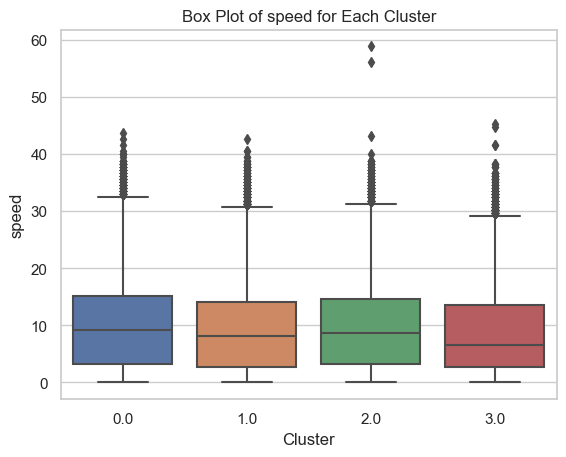

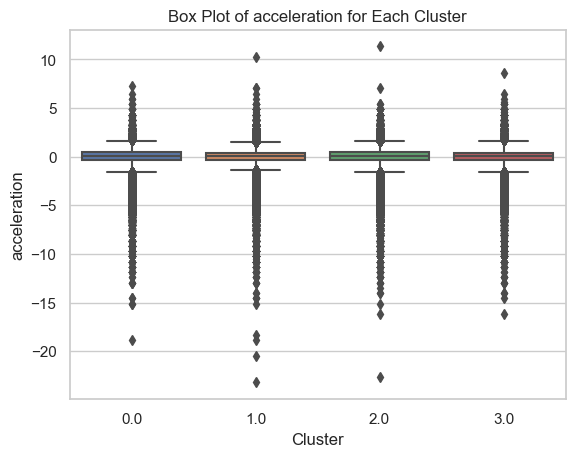

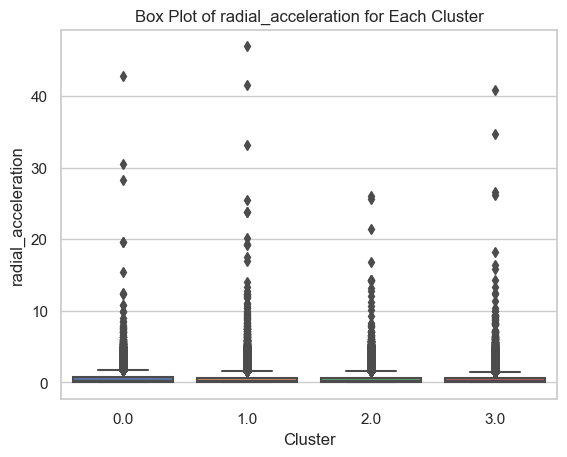

In [99]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming your DataFrame is named cluster_data
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))

# List of features to create box plots for
features = ['speed', 'acceleration', 'radial_acceleration']

for feature in features:
    plt.figure()
    sns.boxplot(x='TScluster', y=feature, data=cluster_data)
    plt.title(f'Box Plot of {feature} for Each Cluster')
    plt.xlabel('Cluster')
    plt.ylabel(feature)
    plt.show()


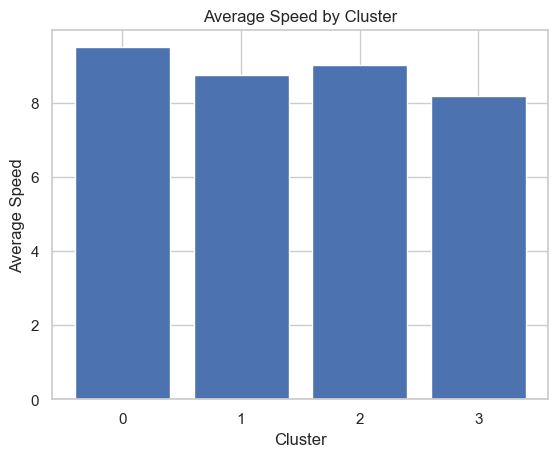

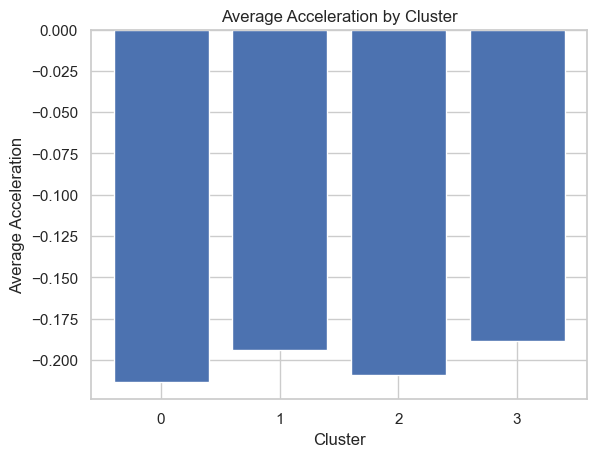

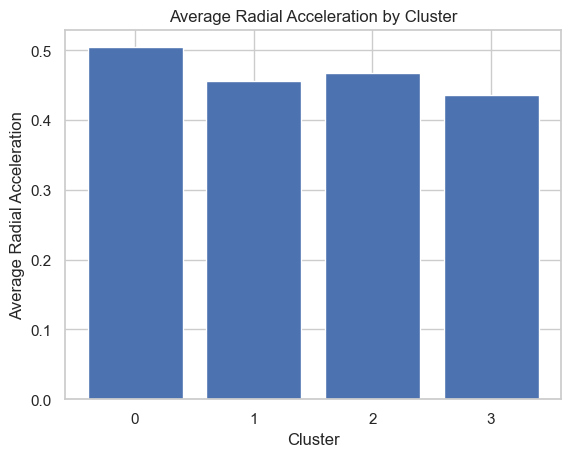

In [100]:
import matplotlib.pyplot as plt


# Calculate average values for each cluster
average_values = TSclusgrped

# Plot bar graph for Average Speed
plt.bar(average_values.index, average_values['speed'])
plt.xlabel('Cluster')
plt.ylabel('Average Speed')
plt.title('Average Speed by Cluster')
plt.xticks(average_values.index)
plt.show()

# Plot bar graph for Average Acceleration
plt.bar(average_values.index, average_values['acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Acceleration')
plt.title('Average Acceleration by Cluster')
plt.xticks(average_values.index)
plt.show()

# Plot bar graph for Average Radial Acceleration
plt.bar(average_values.index, average_values['radial_acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Radial Acceleration')
plt.title('Average Radial Acceleration by Cluster')
plt.xticks(average_values.index)
plt.show()

### assign cluster values to bus ids

In [101]:
cluster_data

,trip_id,deviceid,speed,acceleration,radial_acceleration,distance_from_start,TScluster,NormCluster
0,2.0,116,10.25920,-0.251980,1.278067,123.738485,0.0,1
1,2.0,116,7.55940,-0.179987,0.722300,163.044397,0.0,1
2,2.0,116,3.77970,-0.251980,0.048332,211.472339,0.0,1
3,2.0,116,9.17927,0.359971,1.052222,287.492821,0.0,1
4,2.0,116,8.63931,-0.035997,0.639311,343.141212,0.0,1
...,...,...,...,...,...,...,...,...
624424,5583.0,262,0.00000,-1.259900,0.000000,588.723573,0.0,0
624425,5583.0,262,2.69978,2.699780,0.676495,592.632379,0.0,0
624426,5583.0,262,0.00000,-0.899927,0.000000,595.281264,0.0,0
624427,5583.0,262,1.07991,0.037238,0.000068,604.677749,0.0,0


In [102]:
import pandas as pd

# Assuming your DataFrame is named df
# Group by 'deviceid' and 'TScluster', count occurrences
grouped = cluster_data.groupby(['deviceid', 'TScluster']).size().reset_index(name='count')

# Pivot the data to create a new DataFrame with clusters as columns
pivot_df = grouped.pivot(index='deviceid', columns='TScluster', values='count').fillna(0)

# Calculate the total counts for each bus ID
pivot_df['total'] = pivot_df.sum(axis=1)

# Calculate the percentage of times each cluster was assigned for each bus ID
for cluster in pivot_df.columns[:-1]:
    pivot_df[cluster] = pivot_df[cluster] / pivot_df['total'] * 100

# Reset the index and rename columns
pivot_df.reset_index(inplace=True)
pivot_df.columns.name = None

pivot_df = pivot_df[['deviceid', 0, 1, 2,3]]

# rename cluster culumns
pivot_df.rename(columns={0: 'TSCluster 0', 1: 'TSCluster 1', 2: 'TSCluster 2', 3: 'TSCluster 3'}, inplace=True)

pivot_df


,deviceid,TSCluster 0,TSCluster 1,TSCluster 2,TSCluster 3
0,116,15.800713,34.620046,30.451696,19.127544
1,117,14.806834,35.475128,34.550964,15.167073
2,121,23.186539,24.992301,43.017722,8.803438
3,123,35.000398,21.022343,32.943367,11.033892
4,128,13.275356,35.697031,26.597787,24.429826
5,209,0.000000,51.256831,48.743169,0.000000
6,250,13.315008,39.626563,22.174919,24.883510
7,262,6.950241,34.849924,21.344313,36.855522


In [103]:
# save csv file
pivot_df.to_csv('../DataOut/bus_trip_TSclusters.csv', index=False)

In [104]:
import pandas as pd

# Assuming your DataFrame is named df
# Group by 'deviceid' and 'NormCluster', count occurrences
grouped = cluster_data.groupby(['deviceid', 'NormCluster']).size().reset_index(name='count')

# Pivot the data to create a new DataFrame with clusters as columns
pivot_df2 = grouped.pivot(index='deviceid', columns='NormCluster', values='count').fillna(0)

# Calculate the total counts for each bus ID
pivot_df2['total'] = pivot_df2.sum(axis=1)

# Calculate the percentage of times each cluster was assigned for each bus ID
for cluster in pivot_df2.columns[:-1]:
    pivot_df2[cluster] = pivot_df2[cluster] / pivot_df2['total'] * 100

# Reset the index and rename columns
pivot_df2.reset_index(inplace=True)
pivot_df2.columns.name = None

pivot_df2 = pivot_df2[['deviceid', 0, 1, 2,3]]

# rename cluster culumns
pivot_df2.rename(columns={0: 'NormCluster 0', 1: 'NormCluster 1', 2: 'NormCluster 2', 3: 'NormCluster 3'}, inplace=True)

pivot_df2


,deviceid,NormCluster 0,NormCluster 1,NormCluster 2,NormCluster 3
0,116,4.540050,84.323956,3.231020,7.904974
1,117,50.664086,49.335914,0.000000,0.000000
2,121,45.709566,48.791959,4.853159,0.645315
3,123,64.705882,28.682942,6.611175,0.000000
4,128,64.015560,32.300145,3.408035,0.276260
5,209,77.595628,22.404372,0.000000,0.000000
6,250,56.022259,41.351279,2.626462,0.000000
7,262,58.964587,39.314723,1.412041,0.308650


In [105]:
# save csv file
pivot_df2.to_csv('../DataOut/bus_trip_NormCluster.csv', index=False)

## Visulaise bus running on map

In [106]:
!pip install folium ipywidgets pandas



[notice] A new release of pip available: 22.3.1 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [107]:
pip install ipywidgets


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.3.1 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [108]:
import folium
import pandas as pd
from ipywidgets import interact, IntSlider



# Convert timestamp column to datetime format
data['devicetime'] = pd.to_datetime(data['devicetime'])


In [109]:
data['devicetime'].min()

Timestamp('2021-10-01 06:40:19')

In [110]:
from geopy.geocoders import Nominatim

# Create a geolocator object
geolocator = Nominatim(user_agent="my_geocoder")

# Get the location coordinates (latitude, longitude) for Kandy
Nattarampota_location = geolocator.geocode("Nattarampota, Sri Lanka")
Nattarampota_latitude = Nattarampota_location.latitude
Nattarampota_longitude = Nattarampota_location.longitude

print("Latitude:", Nattarampota_latitude, "Longitude:", Nattarampota_longitude)
Nattarampota_location = [Nattarampota_latitude, Nattarampota_longitude]  # Kandy city location

Latitude: 7.2800104 Longitude: 80.6752889


In [111]:
from geopy.geocoders import Nominatim

# Create a geolocator object
geolocator = Nominatim(user_agent="my_geocoder")

# Get the location coordinates (latitude, longitude) for Kandy
kandy_location = geolocator.geocode("Kandy, Sri Lanka")
kandy_latitude = kandy_location.latitude
kandy_longitude = kandy_location.longitude

print("Latitude:", kandy_latitude, "Longitude:", kandy_longitude)
Kandy_location = [kandy_latitude, kandy_longitude]  # Kandy city location

Latitude: 7.2931208 Longitude: 80.6350358


In [112]:
from geopy.geocoders import Nominatim

# Create a geolocator object
geolocator = Nominatim(user_agent="my_geocoder")

# Get the location coordinates (latitude, longitude) for digana
digana_location = geolocator.geocode("Digana, Sri Lanka")
digana_latitude = digana_location.latitude
digana_longitude = digana_location.longitude

print("Latitude:", digana_latitude, "Longitude:", digana_longitude)
digana_location = [digana_latitude, digana_longitude]  # Kandy city location

Latitude: 7.2964937 Longitude: 80.7334168


In [113]:
data.head(20)

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration,radial_acceleration,distance_from_start,time_diff,acc_diff,acceleration_der,devicetime_seconds
0,574733100,116,2021-10-16 08:03:34,7.293043,80.637552,10.25920,2021-10-16,08:03:34,POINT (184964.84865244984 232317.35306792473),0,2.0,1,-0.251980,1.278067,123.738485,0 days 00:00:15,-0.575955,-0.038397,1300995.0
1,574733101,116,2021-10-16 08:03:49,7.292725,80.637707,7.55940,2021-10-16,08:03:49,POINT (184981.95255171193 232282.14959255166),0,2.0,1,-0.179987,0.722300,163.044397,0 days 00:00:15,0.071993,0.004800,1301010.0
2,574733102,116,2021-10-16 08:04:04,7.292292,80.637663,3.77970,2021-10-16,08:04:04,POINT (184977.15733984314 232234.22458233108),0,2.0,1,-0.251980,0.048332,211.472339,0 days 00:00:15,-0.071993,-0.004800,1301025.0
3,574736662,116,2021-10-16 08:04:19,7.291640,80.637455,9.17927,2021-10-16,08:04:19,POINT (184954.1363920236 232162.16484193364),101,2.0,1,0.359971,1.052222,287.492821,0 days 00:00:15,0.611951,0.040797,1301040.0
4,574736663,116,2021-10-16 08:04:34,7.291210,80.637713,8.63931,2021-10-16,08:04:34,POINT (184982.64260533327 232114.61697960715),101,2.0,1,-0.035997,0.639311,343.141212,0 days 00:00:15,-0.395969,-0.026398,1301055.0
5,574736664,116,2021-10-16 08:04:49,7.290943,80.638160,0.00000,2021-10-16,08:04:49,POINT (185031.9565310351 232085.11003064158),101,2.0,1,-0.575954,0.000000,400.646939,0 days 00:00:15,-0.539957,-0.035997,1301070.0
6,574736665,116,2021-10-16 08:05:04,7.290943,80.638157,0.00000,2021-10-16,08:05:04,POINT (185031.58111776915 232085.11014168937),101,2.0,1,0.000000,0.000000,401.021945,0 days 00:00:15,0.575954,0.038397,1301085.0
7,574736666,116,2021-10-16 08:05:19,7.290943,80.638157,0.00000,2021-10-16,08:05:19,POINT (185031.58111776915 232085.11014168937),101,2.0,1,0.000000,0.000000,401.021945,0 days 00:00:15,0.000000,0.000000,1301100.0
8,574736667,116,2021-10-16 08:05:34,7.290752,80.638305,6.47948,2021-10-16,08:05:34,POINT (185047.9605390529 232063.90664561786),101,2.0,1,0.431965,0.333808,427.897272,0 days 00:00:15,0.431965,0.028798,1301115.0
9,574736668,116,2021-10-16 08:05:49,7.290443,80.638827,9.17927,2021-10-16,08:05:49,POINT (185105.5433407406 232029.79709995503),0,2.0,1,0.179986,0.546434,494.867094,0 days 00:00:15,-0.251979,-0.016799,1301130.0


In [114]:
import folium
import pandas as pd
from shapely.geometry import Point
from ipywidgets import FloatSlider, interact, Label, Output, VBox, Button, HBox

# Assuming you have 'data' DataFrame containing bus data

# Dictionary to store last known location of each bus
bus_locations = {}

# Create Point geometries for Kandy and Digana
kandy_location = Point(kandy_latitude, kandy_longitude)
digana_location = Point(digana_latitude, digana_longitude)  # Define the coordinates for Digana

def create_map():
    return folium.Map(location=Nattarampota_location, zoom_start=14)

def update_map(timestamp):
    m = create_map()  # Create a new map instance each time
    interval = pd.Timedelta(seconds=15)
    timestamp_dt = pd.Timestamp.fromtimestamp(timestamp)  # Convert timestamp to pandas Timestamp
    interval_start = timestamp_dt - interval / 2
    interval_end = timestamp_dt + interval / 2

    bus_data_within_interval = data[(data['devicetime'] >= interval_start) & (data['devicetime'] <= interval_end)]
    bus_data_within_interval = bus_data_within_interval.sort_values(by='devicetime', ascending=False)
    unique_buses = data['deviceid'].unique()

    for deviceid in unique_buses:
        latest_data_for_bus = None  # Initialize the variable here

        bus_data_for_bus = bus_data_within_interval[bus_data_within_interval['deviceid'] == deviceid]
        if len(bus_data_for_bus) > 0:
            latest_data_for_bus = bus_data_for_bus.iloc[0]
            bus_location = [latest_data_for_bus['latitude'], latest_data_for_bus['longitude']]
            bus_locations[deviceid] = bus_location
        else:
            bus_location = bus_locations.get(deviceid)

        if bus_location is not None:
            bus_point = Point(bus_location[0], bus_location[1])

            # Adjust the color using a consistent formula
            color = "#{:06x}".format(deviceid + 100000)

            # get speed acceleration and radial acceleration into three variables
            if latest_data_for_bus is not None:
                speed = latest_data_for_bus['speed']
                acceleration = latest_data_for_bus['acceleration']
                radial_acceleration = latest_data_for_bus['radial_acceleration']
                print(speed, acceleration, radial_acceleration)
            else:
                speed = 0
                acceleration = 0
                radial_acceleration = 0

            folium.Marker(
                location=bus_location,
                popup=[deviceid, speed, acceleration, radial_acceleration],
                color=color  # Use the calculated color
            ).add_to(m)

    return m

min_timestamp = data['devicetime'].min()
max_timestamp = data['devicetime'].max()

# Calculate step size in seconds
step_size_seconds = 15
slider = FloatSlider(value=min_timestamp.timestamp(), min=min_timestamp.timestamp(), max=max_timestamp.timestamp(), step=step_size_seconds)

# Adjust the length of the slider using CSS style
slider.style.handle_length = '500px'  # Adjust the length as desired

time_label = Label(value=pd.Timestamp.fromtimestamp(slider.value).strftime('%Y-%m-%d %H:%M:%S'))

def update_time_label(change):
    time_label.value = pd.Timestamp.fromtimestamp(change['new']).strftime('%Y-%m-%d %H:%M:%S')

slider.observe(update_time_label, 'value')

stop = False  # Declare stop as a global variable

# Button to stop continuous play
def stop_continuous(_):
    global stop
    stop = True
    
# Button to move slider left
def move_left(_):
    slider.value -= step_size_seconds

# Button to move slider right
def move_right(_):
    slider.value += step_size_seconds

# Button to move slider left continuously
def move_left_continuous(_):
    while slider.value > slider.min and not stop:
        slider.value -= step_size_seconds

# Button to move slider right continuously
def move_right_continuous(_):
    while slider.value < slider.max and not stop:
        slider.value += step_size_seconds





left_button = Button(description='<<', icon='angle-left')
right_button = Button(description='>>', icon='angle-right')
left_continuous_button = Button(description='Continuous <<', icon='step-backward')
right_continuous_button = Button(description='Continuous >>', icon='step-forward')
stop_button = Button(description='Stop', icon='stop')

left_button.on_click(move_left)
right_button.on_click(move_right)
left_continuous_button.on_click(move_left_continuous)
right_continuous_button.on_click(move_right_continuous)
stop_button.on_click(stop_continuous)

buttons_row = HBox([left_button, left_continuous_button, right_button, right_continuous_button, stop_button])
controls_box = VBox([buttons_row, slider, time_label])

out_map = Output()
out_map.layout.height = '1000px'  # Adjust the height as desired

def update_map_output(change):
    with out_map:
        out_map.clear_output(wait=True)
        display(update_map(slider.value))

slider.observe(update_map_output, 'value')

app_layout = VBox([controls_box, out_map])

display(app_layout)


In [115]:
# Anomaly trips detected and removed: [166.0, 193.0, 195.0, 207.0, 235.0, 1081.0, 1105.0, 141.0, 147.0, 153.0, 155.0, 157.0, 160.0, 171.0, 177.0, 190.0, 194.0, 206.0, 210.0, 226.0, 879.0]

In [116]:
import folium
from shapely.geometry import Point
import pandas as pd
from geopy.geocoders import Nominatim

# Get the location coordinates (latitude, longitude) for Kandy
kandy_location = geolocator.geocode("Kandy, Sri Lanka")
kandy_latitude = kandy_location.latitude
kandy_longitude = kandy_location.longitude

# Function to create the map
def create_map():
    return folium.Map(location=[kandy_latitude, kandy_longitude], zoom_start=14)

# Function to plot a specific trip on the map
def plot_trip_on_map(trip_id):
    m = create_map()  # Create a new map instance each time
    
    trip_data = data[data['trip_id'] == trip_id]
    trip_data = trip_data.sort_values(by='devicetime')
    
    for index, row in trip_data.iterrows():
        bus_location = [row['latitude'], row['longitude']]
        bus_point = Point(bus_location[0], bus_location[1])
        color = "#{:06x}".format(int(trip_id) + 100000)  # Adjust the color using a consistent formula
        
        # Add a marker for each point in the trip data
        folium.Marker(
            location=bus_location,
            color=color,
            # popup=f"Trip ID: {trip_id}<br>Speed: {row['speed']}<br>Acceleration: {row['acceleration']}<br>Radial Acceleration: {row['radial_acceleration']}"
        ).add_to(m)
    
    return m

# Replace 'your_trip_id_here' with the actual trip ID you want to visualize
trip_id_to_visualize = 193

map_for_trip = plot_trip_on_map(trip_id_to_visualize)
display(map_for_trip)


In [117]:
data[data['trip_id'] == 1364]

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration,radial_acceleration,distance_from_start,time_diff,acc_diff,acceleration_der,devicetime_seconds
771748,1299563295,117,2022-08-04 17:15:45,7.297640,80.732887,10.79910,2022-08-04,17:15:45,POINT (195491.30594940105 232823.64909020616),0,1364.0,2,0.179983,1.276710,91.605952,0 days 00:00:15,0.359967,0.023998,26562926.0
771749,1299563293,117,2022-08-04 17:16:00,7.297470,80.732132,9.17927,2022-08-04,17:16:00,POINT (195407.94191206366 232804.85736157952),0,1364.0,2,-0.107989,0.080101,176.996694,0 days 00:00:15,-0.287972,-0.019198,26562941.0
771750,1299563292,117,2022-08-04 17:16:10,7.297417,80.731808,0.00000,2022-08-04,17:16:10,POINT (195372.24460780175 232798.95541718282),0,1364.0,2,-0.917927,0.000000,213.145831,0 days 00:00:10,-0.809938,-0.080994,26562951.0
771751,1299565184,117,2022-08-04 17:16:51,7.297407,80.731763,2.69978,2022-08-04,17:16:51,POINT (195367.2758882221 232797.85003498162),0,1364.0,2,0.065848,0.014086,218.232107,0 days 00:00:41,0.983775,0.023995,26562992.0
771752,1299566117,117,2022-08-04 17:17:06,7.297323,80.731237,4.85961,2022-08-04,17:17:06,POINT (195309.12010415597 232788.6437219961),0,1364.0,2,0.143989,0.126188,277.057907,0 days 00:00:15,0.078140,0.005209,26563007.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
771973,1299717471,117,2022-08-04 18:08:01,7.290702,80.638240,14.03890,2022-08-04,18:08:01,POINT (185040.78188321402 232058.37964524984),0,1364.0,2,0.036000,0.518467,15302.483848,0 days 00:00:15,0.143993,0.009600,26566062.0
771974,1299717470,117,2022-08-04 18:08:16,7.291212,80.637385,9.71923,2022-08-04,18:08:16,POINT (184946.39321511702 232114.80468345666),0,1364.0,2,-0.287978,0.403176,15412.524775,0 days 00:00:15,-0.323978,-0.021599,26566077.0
771975,1299717467,117,2022-08-04 18:08:31,7.291292,80.636483,15.65880,2022-08-04,18:08:31,POINT (184846.83411249425 232123.68100022638),0,1364.0,2,0.395971,0.328850,15512.375524,0 days 00:00:15,0.683949,0.045597,26566092.0
771976,1299718288,117,2022-08-04 18:08:46,7.291583,80.635315,14.03890,2022-08-04,18:08:46,POINT (184717.84532237818 232155.9767050218),0,1364.0,2,-0.107993,0.632409,15645.253596,0 days 00:00:15,-0.503965,-0.033598,26566107.0
